#### Extract Labels and Save in YOLO Format

#### Load the JSON File

We’ll load the COCO-formatted JSON file. and use that to extract images and labels

# Total images 290

## Model used YOLO8s

In [16]:
from ultralytics import YOLO

model_path = "/home/jovyan/__ANIMALS/datasets/ds0/runs/detect/train5/weights/best.pt"
model = YOLO(model_path)

data_yaml = "/home/jovyan/__ANIMALS/datasets/ds0/animals.yaml"
    
    # Run validation
results = model.val(
        data=data_yaml,
        split='val',
        save_json=True,
        save_conf=True,
        save_txt=True
)
    

Ultralytics 8.3.104 🚀 Python-3.12.7 torch-2.6.0+cu124 CPU (Intel Xeon Processor (Icelake))
Model summary (fused): 72 layers, 3,009,548 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /home/jovyan/__ANIMALS/datasets/ds0/val/labels.cache... 64 images, 0 backgrounds, 0 corrupt: 100%|██████████| 64/64 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:08<00:00,  2.25s/it]


                   all         64         75      0.925      0.504      0.621      0.512
                badger          1          1          1          0      0.332      0.146
                  boar          4          4      0.853        0.5      0.639      0.433
                  lynx          2          2          1          0      0.182      0.138
               red_fox          1          1          1          0          0          0
       roe_deer_female          6         11      0.785          1      0.981      0.879
         roe_deer_male          5          5      0.877        0.6      0.928      0.784
        sika_deer_male          4          8      0.906          1      0.995      0.941
        sika_deer_male          2          2      0.954        0.5      0.828      0.597
                 tiger         38         39      0.965      0.949      0.954      0.822
              wild_cat          1          1          1          0          0          0
         yellow_marte

In [3]:
from ultralytics import YOLO
import pandas as pd

def analyze_yolo_results(model_path, data_yaml):
    # Load model
    model = YOLO(model_path)
    
    # Run validation
    results = model.val(
        data=data_yaml,
        split='val',
        save_json=True,
        save_conf=True,
        save_txt=True
    )
    
    # Create metrics dataframe
    metrics = []
    
    # Get class names and detected metrics
    class_names = results.names
    num_classes = len(class_names)
    
    # Get the actual class ordering from validation output
    val_class_order = []
    if hasattr(results, 'results_dict'):
        val_class_order = [class_names[int(cls)] for cls in results.results_dict.keys() 
                         if cls.isdigit() and int(cls) < num_classes]
    
    # Process all classes
    for class_id in range(num_classes):
        class_name = class_names[class_id]
        
        # Check if class was in validation output
        if class_name in val_class_order or str(class_id) in results.results_dict:
            # Get metrics from results_dict where available
            cls_metrics = results.results_dict.get(str(class_id), {})
            
            metrics.append({
                'Class ID': class_id,
                'Class Name': class_name,
                'Precision': cls_metrics.get('precision', results.box.p[class_id] if class_id < len(results.box.p) else 0),
                'Recall': cls_metrics.get('recall', results.box.r[class_id] if class_id < len(results.box.r) else 0),
                'AP50': cls_metrics.get('mAP50', results.box.ap50[class_id] if class_id < len(results.box.ap50) else 0),
                'AP50-95': cls_metrics.get('mAP50-95', results.box.ap[class_id] if class_id < len(results.box.ap) else 0),
                'F1 Score': 2 * (cls_metrics.get('precision', 0) * cls_metrics.get('recall', 0)) / 
                           (cls_metrics.get('precision', 0) + cls_metrics.get('recall', 0)) 
                           if (cls_metrics.get('precision', 0) + cls_metrics.get('recall', 0)) > 0 else 0,
                'Detected': True,
                'Instances': cls_metrics.get('instances', 0)
            })
        else:
            metrics.append({
                'Class ID': class_id,
                'Class Name': class_name,
                'Precision': 0,
                'Recall': 0,
                'AP50': 0,
                'AP50-95': 0,
                'F1 Score': 0,
                'Detected': False,
                'Instances': 0
            })
    
    # Create DataFrame
    df = pd.DataFrame(metrics)
    
    # Print summary
    print("=== Model Validation Summary ===")
    print(f"mAP50: {results.box.map50:.4f}")
    print(f"mAP50-95: {results.box.map:.4f}")
    print(f"Precision: {results.box.mp:.4f}")
    print(f"Recall: {results.box.mr:.4f}")
    print(f"F1 Score: {2 * (results.box.mp * results.box.mr) / (results.box.mp + results.box.mr):.4f}")
    
    # Print performance
    print("\n=== Performance Metrics ===")
    print(f"Preprocess: {results.speed['preprocess']:.1f}ms/img")
    print(f"Inference: {results.speed['inference']:.1f}ms/img")
    print(f"Postprocess: {results.speed['postprocess']:.1f}ms/img")
    
    return df

# Usage:
df_metrics = analyze_yolo_results(
    model_path='/home/jovyan/__ANIMALS/datasets/ds0/runs/detect/train5/weights/best.pt',
    data_yaml='animals.yaml'
)
print(df_metrics[df_metrics['Detected']])  # Show only detected classes

Ultralytics 8.3.99 🚀 Python-3.12.7 torch-2.6.0+cu124 CPU (Intel Xeon Processor (Icelake))
Model summary (fused): 72 layers, 3,009,548 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /home/jovyan/__ANIMALS/datasets/ds0/val/labels.cache... 64 images, 0 backgrounds, 0 corrupt: 100%|██████████| 64/64 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.06it/s]


                   all         64         75      0.925      0.504      0.621      0.512
                badger          1          1          1          0      0.332      0.146
                  boar          4          4      0.853        0.5      0.639      0.433
                  lynx          2          2          1          0      0.182      0.138
               red_fox          1          1          1          0          0          0
       roe_deer_female          6         11      0.785          1      0.981      0.879
         roe_deer_male          5          5      0.877        0.6      0.928      0.784
        sika_deer_male          4          8      0.906          1      0.995      0.941
        sika_deer_male          2          2      0.954        0.5      0.828      0.597
                 tiger         38         39      0.965      0.949      0.954      0.822
              wild_cat          1          1          1          0          0          0
         yellow_marte

In [17]:
import json
from collections import defaultdict

def analyze_class_distribution(coco_data, dataset_name="Dataset"):
    """Analyze and print detailed class distribution statistics"""
    # Initialize counters
    class_counts = defaultdict(int)
    images_per_class = defaultdict(set)
    
    # Count instances and track images per class
    for ann in coco_data['annotations']:
        class_id = ann['category_id']
        class_counts[class_id] += 1
        images_per_class[class_id].add(ann['image_id'])
    
    # Get class names mapping
    id_to_name = {cat['id']: cat['name'] for cat in coco_data['categories']}
    all_classes = sorted(id_to_name.keys())
    
    # Calculate totals
    total_images = len(coco_data['images'])
    total_instances = sum(class_counts.values())
    
    # Print report header
    print(f"\n{' CLASS DISTRIBUTION ANALYSIS ':=^60}")
    print(f"{dataset_name:^60}")
    print(f"{'Class':<20} {'Images':<10} {'Instances':<10} {'% Images':<10} {'% Instances':<10}")
    print("-" * 60)
    
    # Print each class's statistics
    for class_id in all_classes:
        name = id_to_name[class_id]
        img_count = len(images_per_class.get(class_id, set()))
        inst_count = class_counts.get(class_id, 0)
        
        pct_images = (img_count / total_images * 100) if total_images > 0 else 0
        pct_instances = (inst_count / total_instances * 100) if total_instances > 0 else 0
        
        print(f"{name:<20} {img_count:<10} {inst_count:<10} {pct_images:>8.1f}% {pct_instances:>10.1f}%")
    
    # Print footer with totals
    print("=" * 60)
    print(f"{'TOTAL':<20} {total_images:<10} {total_instances:<10}")
    print(f"{'Unique images with annotations':<20} {len({ann['image_id'] for ann in coco_data['annotations']):<10}")
    print("=" * 60)

def main():
    # Load COCO dataset
    json_file = "result.json"  # Update with your path
    with open(json_file, "r") as f:
        coco_data = json.load(f)
    
    # Analyze distribution
    analyze_class_distribution(coco_data, "Full Dataset")

if __name__ == "__main__":
    main()

SyntaxError: closing parenthesis ')' does not match opening parenthesis '{' (3693728215.py, line 44)

In [39]:
import json
import os
import shutil
from sklearn.model_selection import train_test_split

# Paths
json_file = "result.json"
images_dir = "/home/jovyan/__ANIMALS/images"
train_dir = "train"
val_dir = "val"

# Create train and validation directories
os.makedirs(train_dir, exist_ok=True)
os.makedirs(val_dir, exist_ok=True)

# Load JSON file
with open(json_file, "r") as f:
    coco_data = json.load(f)

# Extract image and annotation data
images = {img["id"]: img["file_name"].split("/")[-1] for img in coco_data["images"]}
annotations = coco_data["annotations"]
categories = {cat["id"]: cat["name"] for cat in coco_data["categories"]}

# Group images by category
category_to_images = {name: [] for name in categories.values()}

for annotation in annotations:
    image_id = annotation["image_id"]
    category_id = annotation["category_id"]
    category_name = categories[category_id]
    
    # Get the image file name and strip the prefix
    full_image_file_name = images[image_id]
    image_file_name = full_image_file_name.split("__")[-1]

    category_to_images[category_name].append(image_file_name)

# Split images into train (80%) and validation (20%) while maintaining class balance
train_images = []
val_images = []

for category, image_list in category_to_images.items():
    if len(image_list) > 1:
        train, val = train_test_split(image_list, test_size=0.2, random_state=42)
    else:
        train, val = image_list, []  # Assign all images to train if there's only one

    train_images.extend(train)
    val_images.extend(val)

print(f"Total train images: {len(train_images)}, Total validation images: {len(val_images)}")

# Copy images to train and validation directories
for img in train_images:
    src = os.path.join(images_dir, img)
    dst = os.path.join(train_dir, img)
    if os.path.exists(src):
        shutil.copyfile(src, dst)
    else:
        print(f"Warning: Train image {img} not found.")

for img in val_images:
    src = os.path.join(images_dir, img)
    dst = os.path.join(val_dir, img)
    if os.path.exists(src):
        shutil.copyfile(src, dst)
    else:
        print(f"Warning: Validation image {img} not found.")

print("Dataset split completed successfully.")

# Generate YOLO-compatible labels
def convert_bbox_to_yolo(image_width, image_height, bbox):
    x, y, width, height = bbox
    x_center = (x + width / 2) / image_width
    y_center = (y + height / 2) / image_height
    width = width / image_width
    height = height / image_height
    return f"{x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}"

# Create labels directories
labels_train_dir = os.path.join(train_dir, "labels")
labels_val_dir = os.path.join(val_dir, "labels")
os.makedirs(labels_train_dir, exist_ok=True)
os.makedirs(labels_val_dir, exist_ok=True)

# Process images and create annotation files
def create_yolo_labels(images_dir, labels_dir):
    for img_id, filename in images.items():
        # Extract image metadata
        img_annotations = [ann for ann in annotations if ann["image_id"] == img_id]
        
        # Skip images without annotations
        if not img_annotations:
            continue
        
        # Determine the correct label file path
        label_filename = filename.split("__")[-1].replace(".JPG", ".txt").replace(".jpg", ".txt")
        label_path = os.path.join(labels_dir, label_filename)

        with open(label_path, "w") as label_file:
            for ann in img_annotations:
                class_id = ann["category_id"]
                bbox = ann["bbox"]
                
                # Get image dimensions from JSON
                img_width = 2048  
                img_height = 1536
                
                # Convert bbox to YOLO format
                yolo_bbox = convert_bbox_to_yolo(img_width, img_height, bbox)
                
                # Write to label file
                label_file.write(f"{class_id} {yolo_bbox}\n")

# Generate labels for train and validation sets
print("Generating YOLO labels for train set...")
create_yolo_labels(train_dir, labels_train_dir)
print("Generating YOLO labels for validation set...")
create_yolo_labels(val_dir, labels_val_dir)

print("YOLO label extraction complete!")

Total train images: 242, Total validation images: 66
Dataset split completed successfully.
Generating YOLO labels for train set...
Generating YOLO labels for validation set...
YOLO label extraction complete!


In [34]:
# lets count the etxracted labels if it matches the number of images

import os

# Paths to label directories
train_labels_dir = "train_m/labels"
val_labels_dir = "val_m/labels"
train_images_dir = "train_m/"
val_images_dir = "val_m/"

def count_files(directory, extension):
    return len([f for f in os.listdir(directory) if f.endswith(extension)])

# Count images and labels
train_image_count = count_files(train_images_dir, ".JPG") + count_files(train_images_dir, ".jpg")
train_label_count = count_files(train_labels_dir, ".txt")
val_image_count = count_files(val_images_dir, ".JPG") + count_files(val_images_dir, ".jpg")
val_label_count = count_files(val_labels_dir, ".txt")

# Print results
print(f"Train Images: {train_image_count}, Train Labels: {train_label_count}")
print(f"Validation Images: {val_image_count}, Validation Labels: {val_label_count}")

# Check for mismatches
if train_image_count != train_label_count:
    print("Warning: Mismatch between train images and labels!")
if val_image_count != val_label_count:
    print("Warning: Mismatch between validation images and labels!")


Train Images: 234, Train Labels: 290
Validation Images: 64, Validation Labels: 290


### Create images directory in both train and val and move all images there

In [40]:
import os
import shutil

# Directories
train_dir = "train"
val_dir = "val"
train_images_dir = os.path.join(train_dir, "images")
val_images_dir = os.path.join(val_dir, "images")

# Create 'images' directories if they don't exist
os.makedirs(train_images_dir, exist_ok=True)
os.makedirs(val_images_dir, exist_ok=True)

# Move images to 'images' directory
def move_images_to_subdir(source_dir, target_dir):
    for file in os.listdir(source_dir):
        if file.lower().endswith((".jpg", ".jpeg", ".png")):
            src = os.path.join(source_dir, file)
            dst = os.path.join(target_dir, file)
            shutil.move(src, dst)
            print(f"Moved {file} to {target_dir}")

# Move images
print("Organizing training images...")
move_images_to_subdir(train_dir, train_images_dir)

print("Organizing validation images...")
move_images_to_subdir(val_dir, val_images_dir)

print("Image organization complete!")

Organizing training images...
Moved Uss-1.1.AnikinRidge_004_12-22-2023_15-40.JPG to train/images
Moved Uss-1.1.AnikinRidge_005_12-22-2023_15-41.JPG to train/images
Moved Uss-1.1.AnikinRidge_008_1-20-2024_15-10.JPG to train/images
Moved Uss-1.1.AnikinRidge_009_1-20-2024_15-55.JPG to train/images
Moved Uss-1.1.AnikinRidge_010_1-20-2024_15-59.JPG to train/images
Moved Uss-1.1.AnikinRidge_012_1-23-2024_18-09.JPG to train/images
Moved Uss-1.1.AnikinRidge_013_1-24-2024_10-12.JPG to train/images
Moved Uss-1.1.AnikinRidge_014_1-28-2024_02-11.JPG to train/images
Moved Uss-1.1.AnikinRidge_015_1-31-2024_02-33.JPG to train/images
Moved Uss-1.1.AnikinRidge_016_2-5-2024_02-02.JPG to train/images
Moved Uss-1.1.AnikinRidge_019_2-15-2024_16-12.JPG to train/images
Moved Uss-1.1.AnikinRidge_020_2-19-2024_05-15.JPG to train/images
Moved Uss-1.1.AnikinRidge_021_2-25-2024_16-27.JPG to train/images
Moved Uss-1.AnikinRidge_002_12-22-2023_15-36.JPG to train/images
Moved Uss-1.AnikinRidge_003_12-22-2023_15-37.J

### Verify if image extraction and labels are okay

In [41]:
import os

# Updated Directories
train_images_dir = os.path.join("train", "images")
val_images_dir = os.path.join("val", "images")
train_labels_dir = os.path.join("train", "labels")
val_labels_dir = os.path.join("val", "labels")

def check_labels_match(images_dir, labels_dir):
    # Get image names without extensions
    images = set(os.path.splitext(f)[0] for f in os.listdir(images_dir) if f.lower().endswith((".jpg", ".jpeg", ".png")))
    labels = set(os.path.splitext(f)[0] for f in os.listdir(labels_dir) if f.endswith(".txt"))
    
    missing_labels = images - labels
    missing_images = labels - images

    print(f"\nChecking {images_dir}:")
    print(f"Total images: {len(images)}, Total labels: {len(labels)}")

    if missing_labels:
        print(f"⚠️ Warning: {len(missing_labels)} images have no corresponding labels:")
        print(missing_labels)

    if missing_images:
        print(f"⚠️ Warning: {len(missing_images)} labels have no corresponding images:")
        print(missing_images)

    return missing_labels, missing_images

# Run checks for train and validation sets
train_missing_labels, train_missing_images = check_labels_match(train_images_dir, train_labels_dir)
val_missing_labels, val_missing_images = check_labels_match(val_images_dir, val_labels_dir)

print("\nLabel verification complete!")



Checking train/images:
Total images: 234, Total labels: 290
⚠️ Warning: 56 labels have no corresponding images:
{'Uss-10.Goluboy_007_12-16-2023_11-28', 'Uss-10.Goluboy_062_2-8-2024_11-10', 'Uss-1.1.AnikinRidge_003_12-21-2023_09-22', 'Uss-1.1.AnikinRidge_007_1-13-2024_13-12', 'Uss-10.1.Goluboy_080_2-8-2024_21-37', 'Uss-11.MokrayaPad_006_12-20-2023_18-12', 'Uss-10.1.Goluboy_157_3-28-2024_15-33', 'Uss-10.Goluboy_067_2-19-2024_17-17', 'Uss-10.Goluboy_046_1-12-2024_23-58', 'Uss-10.1.Goluboy_142_3-28-2024_15-31', 'Uss-10.Goluboy_055_1-12-2024_23-59', 'Uss-1.AnikinRidge_013_2-15-2024_16-11', 'Uss-10.1.Goluboy_126_3-14-2024_18-59', 'Uss-10.1.Goluboy_178_4-16-2024_19-11', 'Uss-10.Goluboy_089_3-30-2024_16-40', 'Uss-10.1.Goluboy_140_3-28-2024_01-32', 'Uss-10.1.Goluboy_018_1-12-2024_15-03', 'Uss-10.1.Goluboy_144_3-28-2024_15-31', 'Uss-10.1.Goluboy_020_1-12-2024_15-04', 'Uss-10.1.Goluboy_155_3-28-2024_15-32', 'Uss-10.Goluboy_021_1-12-2024_15-02', 'Uss-10.1.Goluboy_148_3-28-2024_15-32', 'Uss-10.1.G

### YOLO MODEL

In [1]:
!pip install ultralytics

In [2]:
import os
from ultralytics import YOLO
import matplotlib.pyplot as plt
from PIL import Image

In [3]:
# Define dataset path
dataset_path = "/home/jovyan/__ANIMALS/datasets/ds0"

# Check if dataset exists
if os.path.exists(dataset_path):
    print(f"Dataset found at {dataset_path}")
    print("Training Images:", os.listdir(os.path.join(dataset_path, "train/images"))[:5])
    print("Validation Images:", os.listdir(os.path.join(dataset_path, "val/images/"))[:5])
else:
    print("Dataset not found. Please check the path.")

Dataset found at /home/jovyan/__ANIMALS/datasets/ds0
Training Images: ['Uss-1.1.AnikinRidge_004_12-22-2023_15-40.JPG', 'Uss-1.1.AnikinRidge_005_12-22-2023_15-41.JPG', 'Uss-1.1.AnikinRidge_008_1-20-2024_15-10.JPG', 'Uss-1.1.AnikinRidge_009_1-20-2024_15-55.JPG', 'Uss-1.1.AnikinRidge_010_1-20-2024_15-59.JPG']
Validation Images: ['Uss-1.1.AnikinRidge_002_12-17-2023_15-00.JPG', 'Uss-1.1.AnikinRidge_003_12-21-2023_09-22.JPG', 'Uss-1.1.AnikinRidge_006_1-8-2024_19-13.JPG', 'Uss-1.1.AnikinRidge_007_1-13-2024_13-12.JPG', 'Uss-1.1.AnikinRidge_011_1-21-2024_13-39.JPG']


In [4]:
# Load a pretrained YOLO model
MODEL_NAME = "yolov8s.pt"  # later we can use yolov8s.pt, yolov8m.pt to see if we can get better accuracy
model = YOLO(MODEL_NAME)

# Check if the model file exists
if os.path.exists(MODEL_NAME):
    print(f"Model {MODEL_NAME} loaded successfully.")
else:
    print(f"Model file {MODEL_NAME} not found. Please check the path.")


100%|██████████| 21.5M/21.5M [00:00<00:00, 42.5MB/s]


Model yolov8s.pt loaded successfully.


In [ ]:
# Train the model using the animals dataset
results = model.train(
    data="animals.yaml",  
    epochs=120,       
    batch=16,             
    imgsz=640,  
)


Ultralytics 8.3.71 🚀 Python-3.12.7 torch-2.6.0+cu124 CPU (Intel Xeon Processor (Icelake))
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=animals.yaml, epochs=120, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train6, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=Tru

train: Scanning /home/jovyan/__ANIMALS/datasets/ds0/train/labels.cache... 234 images, 0 backgrounds, 0 corrupt: 100%|██████████| 234/234 [00:00<?, ?it/s]
val: Scanning /home/jovyan/__ANIMALS/datasets/ds0/val/labels.cache... 64 images, 0 backgrounds, 0 corrupt: 100%|██████████| 64/64 [00:00<?, ?it/s]


Plotting labels to runs/detect/train6/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000417, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs/detect/train6
Starting training for 120 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/120         0G      1.165      5.367      1.392         33        640: 100%|██████████| 15/15 [00:51<00:00,  3.45s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:05<00:05,  5.80s/it]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:11<00:00,  5.78s/it]

                   all         64         75      0.279      0.111      0.113      0.085



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/120         0G     0.9465       2.93      1.225         19        640: 100%|██████████| 15/15 [00:47<00:00,  3.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:10<00:00,  5.32s/it]

                   all         64         75      0.703      0.247      0.268      0.207



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/120         0G     0.9134      2.094      1.177         19        640: 100%|██████████| 15/15 [00:46<00:00,  3.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:05<00:00,  2.64s/it]

                   all         64         75       0.72      0.313       0.32      0.231



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/120         0G     0.8592      1.729      1.132         17        640: 100%|██████████| 15/15 [00:46<00:00,  3.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.20s/it]

                   all         64         75      0.778      0.317       0.32       0.24



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/120         0G     0.9447      1.588      1.189         29        640: 100%|██████████| 15/15 [00:47<00:00,  3.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.16s/it]

                   all         64         75      0.547      0.514      0.403      0.301



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/120         0G     0.8865      1.453      1.131         26        640: 100%|██████████| 15/15 [00:46<00:00,  3.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.17s/it]

                   all         64         75      0.863      0.309       0.38      0.273



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/120         0G     0.9341      1.337      1.143         19        640: 100%|██████████| 15/15 [00:47<00:00,  3.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.16s/it]

                   all         64         75      0.645      0.393      0.431      0.295



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/120         0G     0.9044      1.259      1.159         19        640: 100%|██████████| 15/15 [00:48<00:00,  3.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.14s/it]

                   all         64         75      0.589      0.454      0.516      0.366



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/120         0G     0.8297      1.043      1.109         18        640: 100%|██████████| 15/15 [00:46<00:00,  3.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.21s/it]

                   all         64         75      0.856      0.394      0.654      0.468



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/120         0G     0.8821      1.096      1.162         29        640: 100%|██████████| 15/15 [00:46<00:00,  3.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.22s/it]

                   all         64         75      0.689      0.388      0.505       0.35



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/120         0G     0.8788      1.028      1.139         22        640: 100%|██████████| 15/15 [00:46<00:00,  3.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.15s/it]

                   all         64         75      0.926      0.271      0.451      0.293



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/120         0G     0.8591      1.032      1.149         17        640: 100%|██████████| 15/15 [00:46<00:00,  3.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.12s/it]

                   all         64         75      0.786      0.395      0.481      0.349



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/120         0G     0.8037     0.9104      1.112         26        640: 100%|██████████| 15/15 [00:47<00:00,  3.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.15s/it]

                   all         64         75      0.812      0.382      0.648      0.456



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/120         0G     0.7745     0.8917      1.113         21        640: 100%|██████████| 15/15 [00:46<00:00,  3.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.14s/it]

                   all         64         75      0.902      0.309      0.567      0.394



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/120         0G     0.7992     0.8906      1.104         22        640: 100%|██████████| 15/15 [00:47<00:00,  3.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.13s/it]

                   all         64         75      0.618      0.448      0.553      0.387



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/120         0G     0.7408     0.7841      1.038         20        640: 100%|██████████| 15/15 [00:46<00:00,  3.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.39s/it]

                   all         64         75      0.556      0.441      0.509      0.371



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/120         0G     0.7255     0.7555      1.041         21        640: 100%|██████████| 15/15 [00:46<00:00,  3.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.15s/it]

                   all         64         75      0.875      0.368      0.623      0.448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/120         0G     0.8029     0.8428      1.113         29        640: 100%|██████████| 15/15 [00:47<00:00,  3.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.10s/it]

                   all         64         75      0.663      0.465      0.597      0.438



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/120         0G     0.7727     0.8064      1.106         20        640: 100%|██████████| 15/15 [00:46<00:00,  3.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.19s/it]

                   all         64         75      0.685      0.404      0.552      0.397



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/120         0G     0.7654     0.7512      1.095         20        640: 100%|██████████| 15/15 [00:48<00:00,  3.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.12s/it]

                   all         64         75      0.928      0.384       0.59      0.434



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/120         0G     0.7186     0.7078       1.06         27        640: 100%|██████████| 15/15 [00:46<00:00,  3.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.22s/it]

                   all         64         75      0.854      0.408      0.582      0.442



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/120         0G     0.7614     0.7431      1.052         26        640: 100%|██████████| 15/15 [00:45<00:00,  3.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.11s/it]

                   all         64         75      0.568       0.52      0.573      0.428



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/120         0G     0.7092     0.7223      1.023         16        640: 100%|██████████| 15/15 [00:47<00:00,  3.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.14s/it]

                   all         64         75       0.87      0.459      0.579      0.454



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/120         0G     0.7487     0.7034      1.067         16        640: 100%|██████████| 15/15 [00:46<00:00,  3.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.11s/it]

                   all         64         75      0.786      0.449      0.585       0.45



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/120         0G     0.6658     0.7086      1.035         21        640: 100%|██████████| 15/15 [00:48<00:00,  3.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.11s/it]

                   all         64         75      0.634      0.375      0.516       0.42



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/120         0G     0.6611     0.6363      1.041         21        640: 100%|██████████| 15/15 [00:47<00:00,  3.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.14s/it]

                   all         64         75       0.65      0.495       0.52      0.411



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/120         0G     0.6761     0.6598      1.036         18        640: 100%|██████████| 15/15 [00:46<00:00,  3.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.12s/it]

                   all         64         75      0.546      0.423      0.471      0.364



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/120         0G      0.648     0.6141       1.01         16        640: 100%|██████████| 15/15 [00:47<00:00,  3.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.14s/it]

                   all         64         75      0.932      0.538      0.583      0.443



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/120         0G     0.6542     0.5729      1.021         18        640: 100%|██████████| 15/15 [00:46<00:00,  3.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.11s/it]

                   all         64         75      0.928      0.539      0.585      0.443



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/120         0G     0.6356     0.5589      1.005         22        640: 100%|██████████| 15/15 [00:48<00:00,  3.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.13s/it]

                   all         64         75      0.826       0.55      0.559      0.446



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/120         0G     0.6421     0.5364      1.019         25        640: 100%|██████████| 15/15 [00:47<00:00,  3.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.15s/it]

                   all         64         75      0.826      0.471      0.596      0.482



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/120         0G      0.673     0.5765      1.009         22        640: 100%|██████████| 15/15 [00:46<00:00,  3.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.10s/it]

                   all         64         75      0.776      0.638      0.624      0.482



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/120         0G     0.6188      0.575     0.9989         21        640: 100%|██████████| 15/15 [00:47<00:00,  3.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.12s/it]

                   all         64         75       0.96      0.482      0.655      0.506



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/120         0G     0.6556     0.5613      1.004         24        640: 100%|██████████| 15/15 [00:47<00:00,  3.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.13s/it]

                   all         64         75      0.928      0.514      0.705      0.592



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/120         0G     0.6304     0.5428      1.005         21        640: 100%|██████████| 15/15 [00:48<00:00,  3.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.14s/it]

                   all         64         75      0.814      0.637      0.711      0.592



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/120         0G     0.6375     0.5535      1.015         22        640: 100%|██████████| 15/15 [00:47<00:00,  3.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.12s/it]

                   all         64         75      0.893      0.568      0.704      0.593



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/120         0G     0.6415     0.5664     0.9968         29        640: 100%|██████████| 15/15 [00:47<00:00,  3.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:05<00:00,  2.95s/it]

                   all         64         75      0.878      0.477      0.677      0.548



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/120         0G     0.6241     0.5517     0.9904         14        640: 100%|██████████| 15/15 [00:47<00:00,  3.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.13s/it]

                   all         64         75      0.813      0.432      0.772      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/120         0G     0.6254     0.5376     0.9939         27        640: 100%|██████████| 15/15 [00:46<00:00,  3.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.14s/it]

                   all         64         75      0.732      0.541       0.77      0.574



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/120         0G     0.6076     0.5105     0.9982         22        640: 100%|██████████| 15/15 [00:47<00:00,  3.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.13s/it]

                   all         64         75      0.706       0.45      0.711      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/120         0G     0.6317     0.5529      1.002         18        640: 100%|██████████| 15/15 [00:46<00:00,  3.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.12s/it]

                   all         64         75      0.722      0.641      0.796       0.59



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/120         0G     0.5918     0.5227      0.986         30        640: 100%|██████████| 15/15 [00:47<00:00,  3.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:06<00:00,  3.36s/it]

                   all         64         75      0.587      0.641      0.666      0.524



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/120         0G     0.5995     0.5149      0.989         23        640: 100%|██████████| 15/15 [00:47<00:00,  3.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.16s/it]

                   all         64         75      0.939      0.449      0.651       0.48



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/120         0G     0.5819      0.496     0.9774         23        640: 100%|██████████| 15/15 [00:47<00:00,  3.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.12s/it]

                   all         64         75      0.834      0.568      0.588      0.475



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/120         0G      0.577     0.4707     0.9895         30        640: 100%|██████████| 15/15 [00:48<00:00,  3.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.11s/it]

                   all         64         75      0.852      0.473      0.583      0.487



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/120         0G      0.573     0.4785     0.9758         21        640: 100%|██████████| 15/15 [00:46<00:00,  3.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.15s/it]

                   all         64         75      0.826       0.47      0.643      0.513



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/120         0G     0.5714     0.4712     0.9798         17        640: 100%|██████████| 15/15 [00:46<00:00,  3.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.12s/it]

                   all         64         75       0.74      0.585      0.641      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/120         0G     0.5744      0.487     0.9866         21        640: 100%|██████████| 15/15 [00:46<00:00,  3.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.18s/it]

                   all         64         75       0.85      0.589      0.739      0.558



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/120         0G     0.5829     0.4793     0.9707         19        640: 100%|██████████| 15/15 [00:47<00:00,  3.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.16s/it]

                   all         64         75      0.831      0.589      0.742      0.559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/120         0G     0.5672     0.4846     0.9694         16        640: 100%|██████████| 15/15 [00:46<00:00,  3.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.12s/it]

                   all         64         75      0.728      0.589      0.713      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/120         0G     0.5653     0.4455     0.9686         16        640: 100%|██████████| 15/15 [00:46<00:00,  3.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.14s/it]

                   all         64         75      0.699      0.589      0.704      0.549



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/120         0G     0.5613     0.4437     0.9647         20        640: 100%|██████████| 15/15 [00:48<00:00,  3.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.13s/it]

                   all         64         75      0.669      0.616      0.702      0.554



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/120         0G     0.5424      0.407     0.9417         24        640: 100%|██████████| 15/15 [00:46<00:00,  3.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.16s/it]

                   all         64         75       0.78       0.57      0.749      0.587



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/120         0G     0.5553      0.429     0.9564         32        640: 100%|██████████| 15/15 [00:46<00:00,  3.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.15s/it]

                   all         64         75      0.753      0.613      0.746      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/120         0G     0.5386     0.4158     0.9631         15        640: 100%|██████████| 15/15 [00:47<00:00,  3.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.11s/it]

                   all         64         75      0.846      0.633      0.694      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/120         0G     0.5393     0.4355     0.9497         23        640: 100%|██████████| 15/15 [00:46<00:00,  3.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.14s/it]

                   all         64         75      0.799      0.651      0.764      0.565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/120         0G     0.5388     0.4293     0.9486         19        640: 100%|██████████| 15/15 [00:46<00:00,  3.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.12s/it]

                   all         64         75      0.794      0.586      0.765      0.599



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/120         0G     0.5164     0.4303     0.9651         12        640: 100%|██████████| 15/15 [00:47<00:00,  3.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.17s/it]

                   all         64         75      0.728      0.586      0.689      0.536



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/120         0G     0.5179     0.4124     0.9417         24        640: 100%|██████████| 15/15 [00:46<00:00,  3.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.11s/it]

                   all         64         75      0.582      0.679      0.685      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/120         0G     0.5265     0.3887     0.9583         25        640: 100%|██████████| 15/15 [00:47<00:00,  3.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.15s/it]

                   all         64         75      0.665      0.679      0.685      0.519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/120         0G     0.4895     0.3971     0.9369         17        640: 100%|██████████| 15/15 [00:47<00:00,  3.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.19s/it]

                   all         64         75      0.609      0.679      0.709      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/120         0G     0.4924     0.3838     0.9288         21        640: 100%|██████████| 15/15 [00:48<00:00,  3.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.21s/it]

                   all         64         75      0.727      0.498      0.629       0.49



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/120         0G     0.5066     0.3821     0.9324         21        640: 100%|██████████| 15/15 [00:47<00:00,  3.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.13s/it]

                   all         64         75      0.925      0.498      0.704       0.59



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/120         0G     0.4863     0.4223     0.9293         20        640: 100%|██████████| 15/15 [00:46<00:00,  3.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.14s/it]

                   all         64         75      0.955      0.495        0.7      0.583



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/120         0G     0.5045     0.3841     0.9515         24        640: 100%|██████████| 15/15 [00:47<00:00,  3.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.13s/it]

                   all         64         75      0.931      0.494      0.677      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/120         0G     0.4896     0.3762     0.9304         19        640: 100%|██████████| 15/15 [00:47<00:00,  3.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.13s/it]

                   all         64         75      0.741      0.584      0.674       0.54



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/120         0G     0.5023      0.389      0.939         22        640: 100%|██████████| 15/15 [00:47<00:00,  3.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.16s/it]

                   all         64         75      0.965      0.487      0.684      0.548



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/120         0G     0.4643     0.3665     0.9279         20        640: 100%|██████████| 15/15 [00:46<00:00,  3.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.13s/it]

                   all         64         75        0.7      0.648       0.74      0.566



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/120         0G     0.5199     0.3814     0.9576         14        640: 100%|██████████| 15/15 [00:46<00:00,  3.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.14s/it]

                   all         64         75      0.817      0.575      0.741      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/120         0G     0.4509     0.3714     0.9184         22        640: 100%|██████████| 15/15 [00:46<00:00,  3.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.09s/it]

                   all         64         75      0.947      0.498      0.746      0.583



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/120         0G     0.4764     0.3659     0.9381         21        640: 100%|██████████| 15/15 [00:47<00:00,  3.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.14s/it]

                   all         64         75      0.813      0.589      0.728       0.57



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/120         0G     0.4677     0.3614     0.9412         14        640: 100%|██████████| 15/15 [00:48<00:00,  3.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.13s/it]

                   all         64         75      0.847      0.589      0.703      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/120         0G      0.471     0.3741     0.9231         30        640: 100%|██████████| 15/15 [00:46<00:00,  3.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.20s/it]

                   all         64         75      0.889      0.589      0.695      0.559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/120         0G      0.447     0.3521     0.9177         19        640: 100%|██████████| 15/15 [00:45<00:00,  3.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.10s/it]

                   all         64         75       0.82      0.589      0.676      0.542



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/120         0G     0.4587     0.3527     0.9131         24        640: 100%|██████████| 15/15 [00:46<00:00,  3.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.17s/it]

                   all         64         75      0.899      0.495      0.683      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/120         0G     0.4528     0.3523     0.9228         23        640: 100%|██████████| 15/15 [00:46<00:00,  3.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.14s/it]

                   all         64         75      0.878      0.479      0.697      0.544



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/120         0G     0.4516     0.3515      0.932         17        640: 100%|██████████| 15/15 [00:47<00:00,  3.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.14s/it]

                   all         64         75      0.856      0.501      0.729      0.558



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/120         0G      0.466      0.355     0.9228         19        640: 100%|██████████| 15/15 [00:46<00:00,  3.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.15s/it]

                   all         64         75      0.881      0.501      0.729      0.554



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/120         0G     0.4466     0.3409     0.9212         21        640: 100%|██████████| 15/15 [00:47<00:00,  3.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.13s/it]

                   all         64         75      0.875       0.61      0.719      0.575



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/120         0G     0.4478     0.3508       0.93         24        640: 100%|██████████| 15/15 [00:47<00:00,  3.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.11s/it]

                   all         64         75      0.853      0.589      0.712      0.577



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/120         0G     0.4496     0.3539      0.911         20        640: 100%|██████████| 15/15 [00:46<00:00,  3.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.10s/it]

                   all         64         75       0.83      0.589      0.719      0.593



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/120         0G     0.4166     0.3337     0.9123         25        640: 100%|██████████| 15/15 [00:48<00:00,  3.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.13s/it]

                   all         64         75      0.899      0.607      0.744      0.598



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/120         0G     0.4467     0.3375     0.9431         18        640: 100%|██████████| 15/15 [00:46<00:00,  3.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.25s/it]

                   all         64         75      0.905      0.605      0.733      0.585



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/120         0G     0.4304     0.3355     0.9235         34        640: 100%|██████████| 15/15 [00:46<00:00,  3.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.16s/it]

                   all         64         75      0.904      0.589      0.687      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/120         0G     0.4162     0.3214      0.924         19        640: 100%|██████████| 15/15 [00:46<00:00,  3.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.13s/it]

                   all         64         75      0.922      0.589      0.684      0.559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/120         0G     0.4264     0.3279     0.8812         35        640:  27%|██▋       | 4/15 [00:12<00:33,  3.08s/it]

### Plot few Images from validation

In [ ]:
ls runs/detect/train5/weights/

In [ ]:
model = YOLO("runs/detect/train6/weights/best.pt")
results = model.predict("test_tiger.jpg", save=True)

In [ ]:
%matplotlib inline

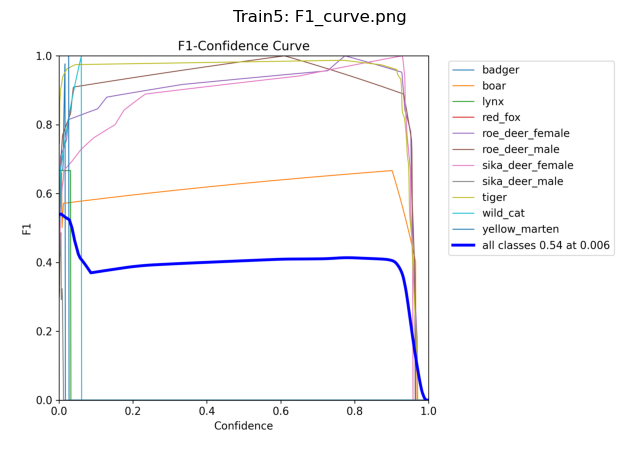

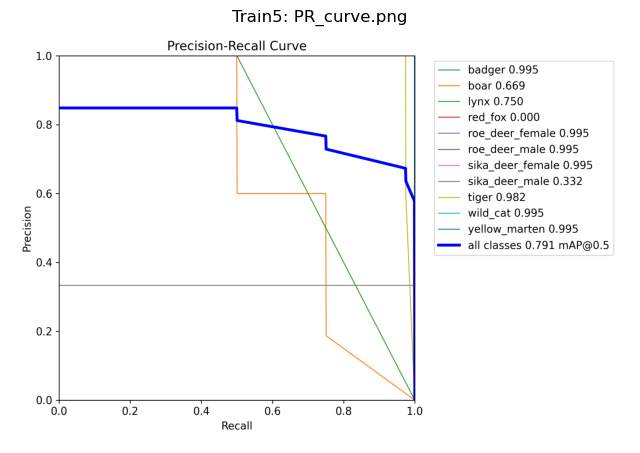

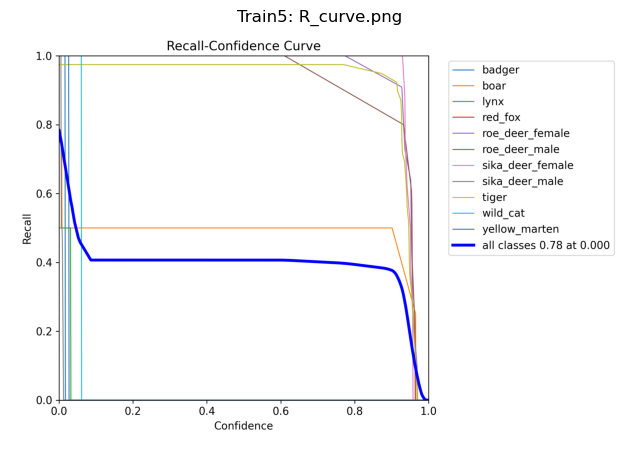

In [41]:
import os
import matplotlib.pyplot as plt
from PIL import Image

# Path to the train5 folder
train5_dir = "runs/detect/train6"

# List of metrics to plot
metrics = ["F1_curve.png", "PR_curve.png", "R_curve.png"]

# Plot each metric
for metric in metrics:
    metric_path = os.path.join(train5_dir, metric)
    if os.path.exists(metric_path):
        img = Image.open(metric_path)
        plt.figure(figsize=(8, 6))
        plt.imshow(img)
        plt.title(f"Train5: {metric}")
        plt.axis('off')
        plt.show()
    else:
        print(f"Warning: {metric} not found in {train5_dir}.")

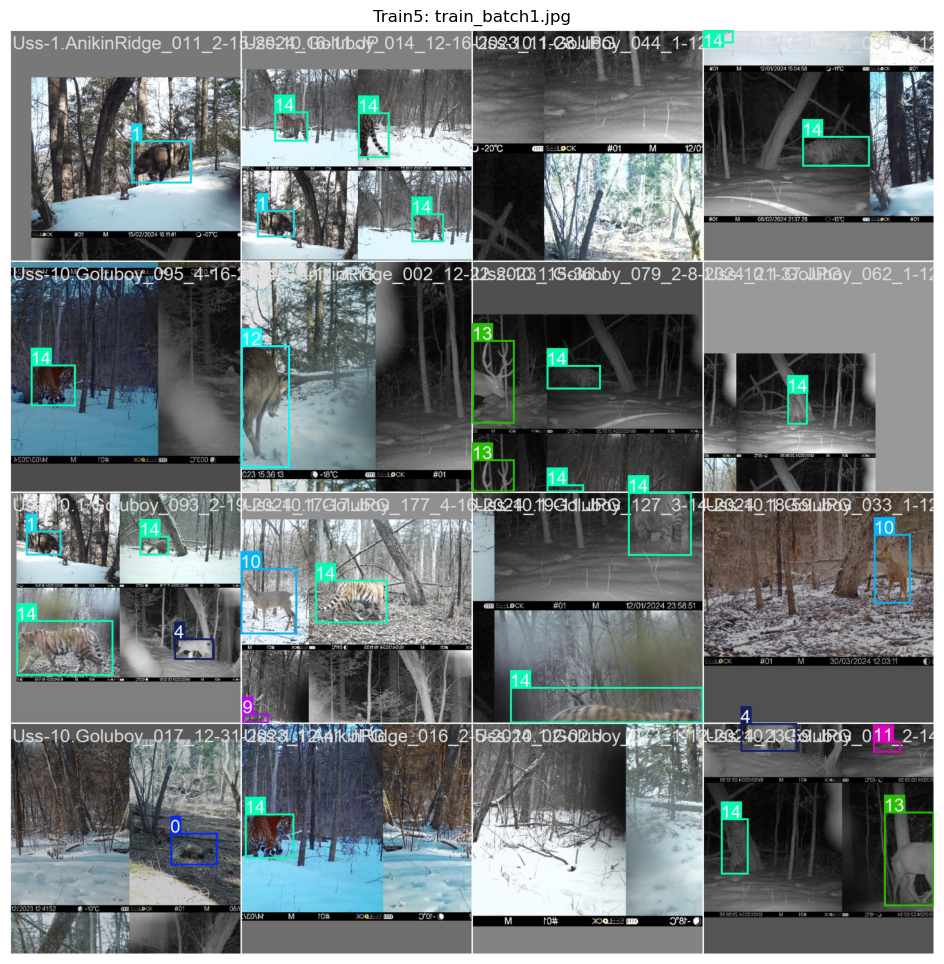

In [42]:
import os
import matplotlib.pyplot as plt
from PIL import Image

# Path to the train5 folder
train5_dir = "runs/detect/train6"

# List of metrics to plot
metrics = ["train_batch1.jpg"]

# Plot each metric
for metric in metrics:
    metric_path = os.path.join(train5_dir, metric)
    if os.path.exists(metric_path):
        img = Image.open(metric_path)
        plt.figure(figsize=(18, 12))
        plt.imshow(img)
        plt.title(f"Train5: {metric}")
        plt.axis('off')
        plt.show()
    else:
        print(f"Warning: {metric} not found in {train5_dir}.")

In [ ]:
# Path to the val folder
val_dir = "runs/detect/val"

metrics = ["F1_curve.png", "PR_curve.png", "R_curve.png"]

# Plot each metric
for metric in metrics:
    metric_path = os.path.join(val_dir, metric)
    if os.path.exists(metric_path):
        img = Image.open(metric_path)
        plt.figure(figsize=(8, 6))
        plt.imshow(img)
        plt.title(f"Validation: {metric}")
        plt.axis('off')
        plt.show()
    else:
        print(f"Warning: {metric} not found in {val_dir}.")

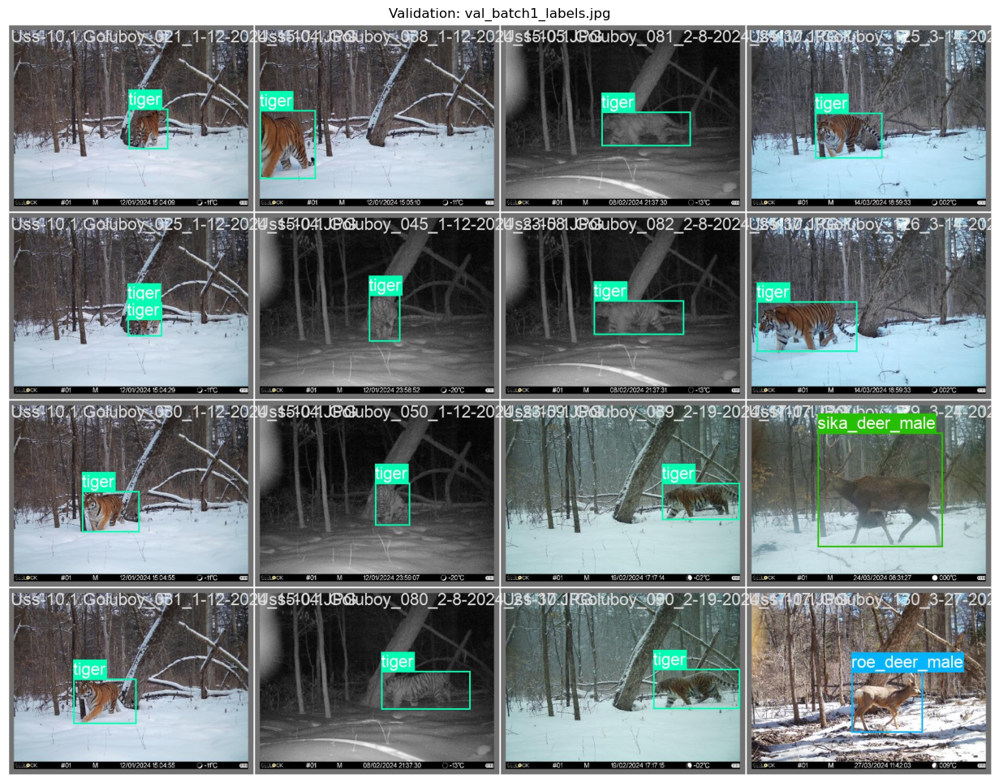

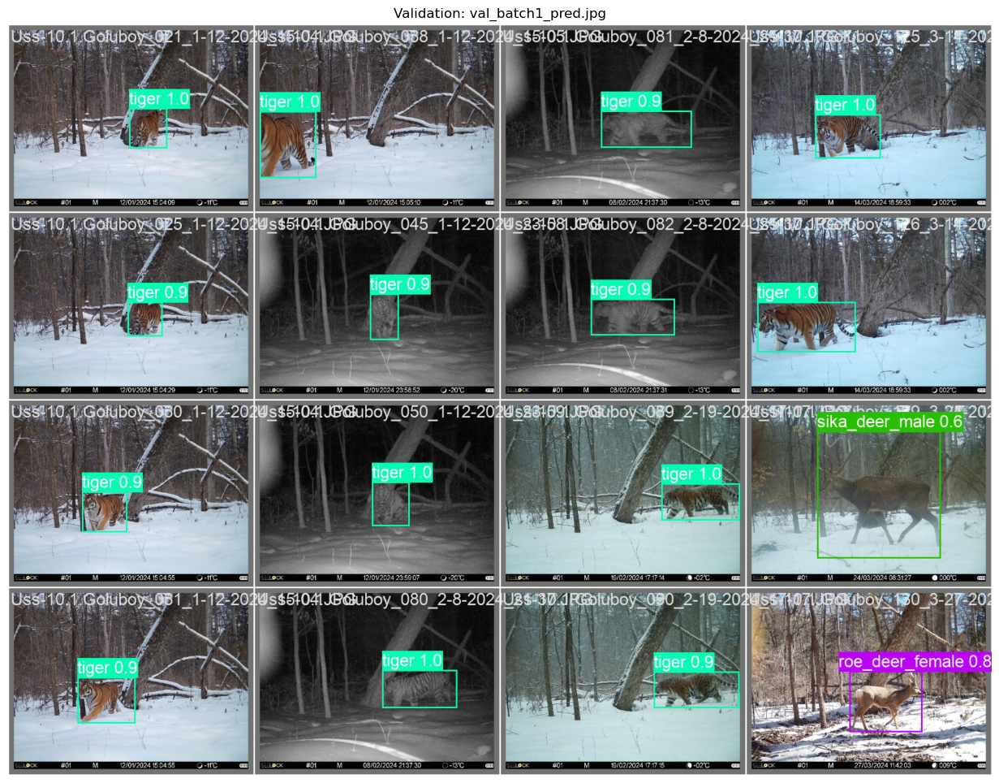

In [40]:
# Path to the val folder
val_dir = "runs/detect/val"

metrics = ["val_batch1_labels.jpg", "val_batch1_pred.jpg"]

# Plot each metric
for metric in metrics:
    metric_path = os.path.join(val_dir, metric)
    if os.path.exists(metric_path):
        img = Image.open(metric_path)
        plt.figure(figsize=(18, 12))
        plt.imshow(img)
        plt.title(f"Validation: {metric}")
        plt.axis('off')
        plt.show()
    else:
        print(f"Warning: {metric} not found in {val_dir}.")

#### Making Predictions on Random Images

In [ ]:
import os
import random

# Directory containing images
images_dir = "/home/jovyan/__ANIMALS/images"

# Select 3 random images
image_files = [f for f in os.listdir(images_dir) if f.lower().endswith(('.jpg', '.png', '.jpeg'))]
random_images = random.sample(image_files, min(3, len(image_files)))

# Print selected images
print("Selected images for prediction:")
for img in random_images:
    print(img)

In [39]:
from ultralytics import YOLO

# Load the trained YOLO model
model = YOLO("runs/detect/train5/weights/best.pt")

In [47]:
# Make predictions and save results
for img in random_images:
    img_path = os.path.join(images_dir, img)
    results = model.predict(img_path, save=True, save_dir="runs/detect/predict")
    print(f"Prediction saved for {img} in runs/detect/predict.")


image 1/1 /home/jovyan/__ANIMALS/images/Uss-25.1.PravayaKomarovka_209_1-22-2024_11-54.JPG: 480x640 1 roe_deer_female, 26.3ms
Speed: 2.6ms preprocess, 26.3ms inference, 0.6ms postprocess per image at shape (1, 3, 480, 640)
Results saved to runs/detect/predict2
Prediction saved for Uss-25.1.PravayaKomarovka_209_1-22-2024_11-54.JPG in runs/detect/predict.

image 1/1 /home/jovyan/__ANIMALS/images/Uss-42.1.Komagorov_112_3-25-2024_17-58.JPG: 480x640 1 tiger, 24.0ms
Speed: 2.3ms preprocess, 24.0ms inference, 0.6ms postprocess per image at shape (1, 3, 480, 640)
Results saved to runs/detect/predict2
Prediction saved for Uss-42.1.Komagorov_112_3-25-2024_17-58.JPG in runs/detect/predict.

image 1/1 /home/jovyan/__ANIMALS/images/Uss-53.Osetinsky_021_3-23-2024_16-21.JPG: 480x640 1 sika_deer_male, 35.7ms
Speed: 2.3ms preprocess, 35.7ms inference, 0.7ms postprocess per image at shape (1, 3, 480, 640)
Results saved to runs/detect/predict2
Prediction saved for Uss-53.Osetinsky_021_3-23-2024_16-21.JPG

In [48]:
import os

# Path to the predict folder
predict_dir = "runs/detect/predict2"

# List all files in the predict folder
predicted_files = os.listdir(predict_dir)
print("Predicted files in runs/detect/predict2:")
for file in predicted_files:
    print(file)

Predicted files in runs/detect/predict2:
.ipynb_checkpoints
Uss-10.1.Goluboy_110_3-14-2024_18-58.jpg
Uss-25.1.PravayaKomarovka_209_1-22-2024_11-54.jpg
Uss-25.1.PravayaKomarovka_474_2-13-2024_09-09.jpg
Uss-42.1.Komagorov_112_3-25-2024_17-58.jpg
Uss-53.Osetinsky_021_3-23-2024_16-21.jpg
Uss-62.Komarovka_084_1-23-2024_19-22.jpg


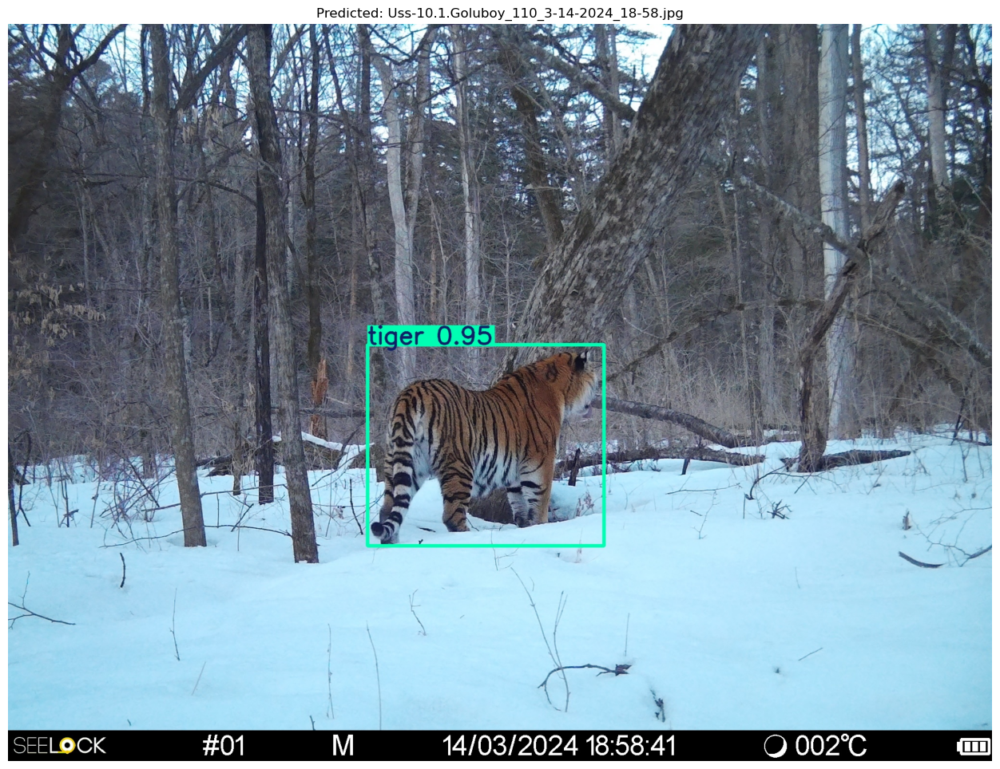

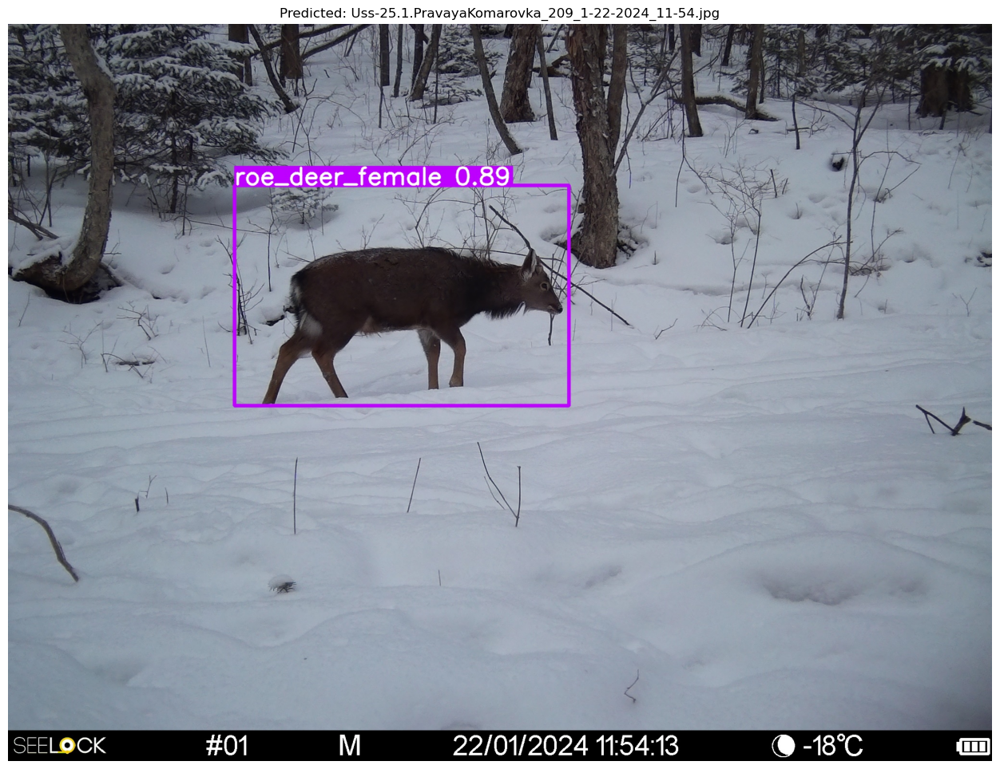

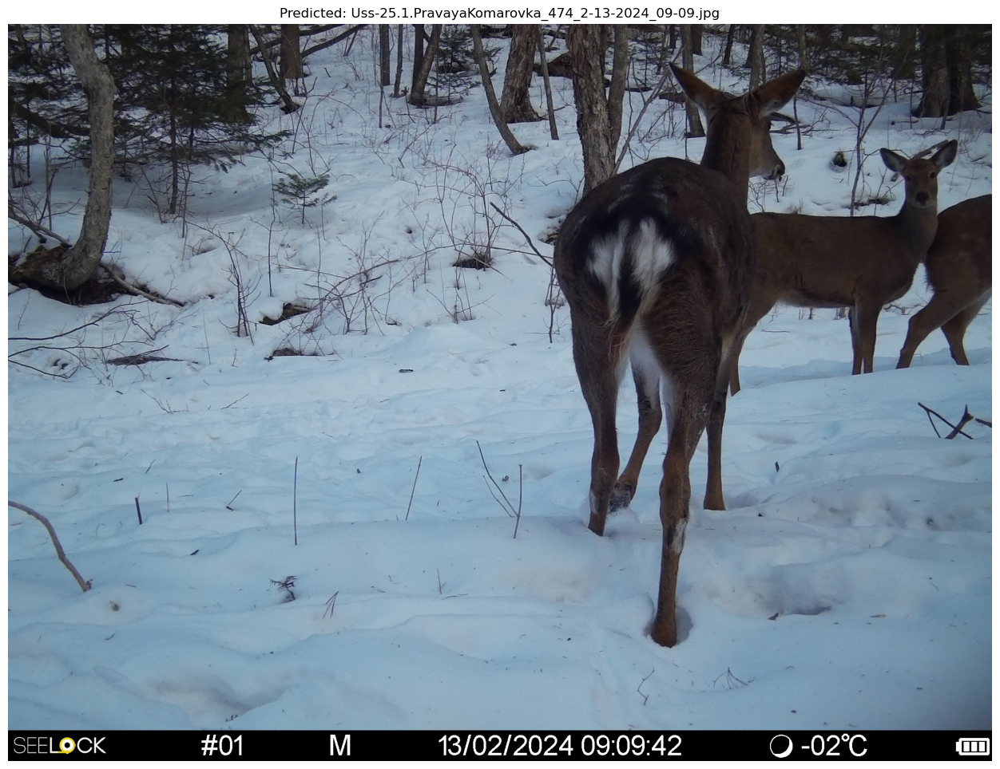

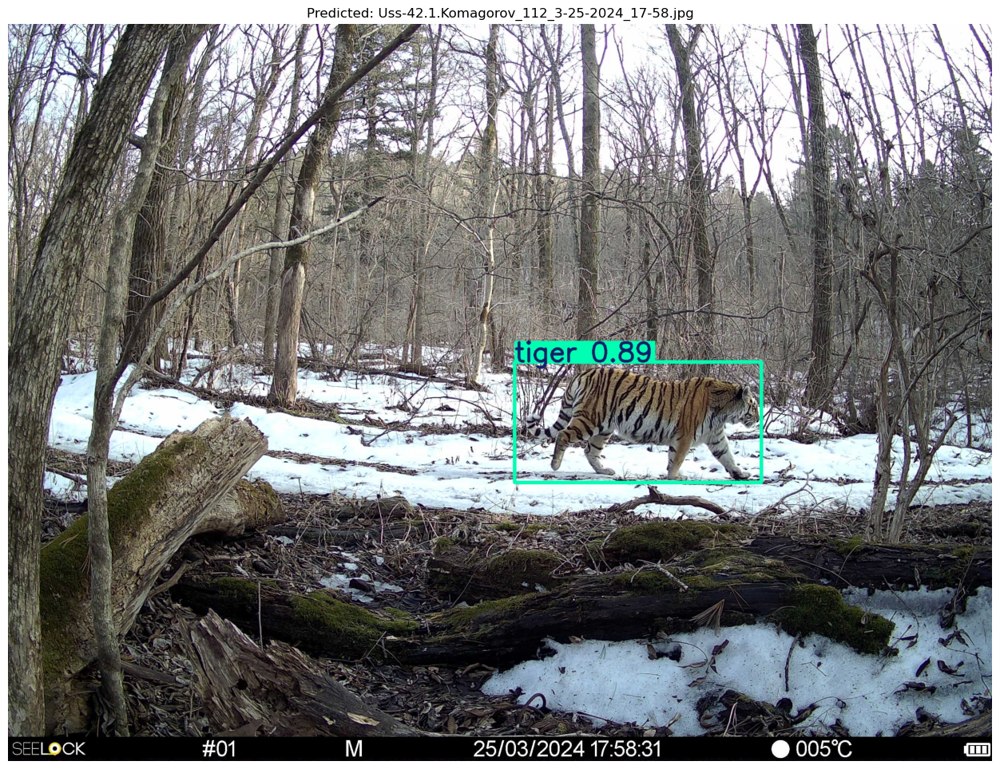

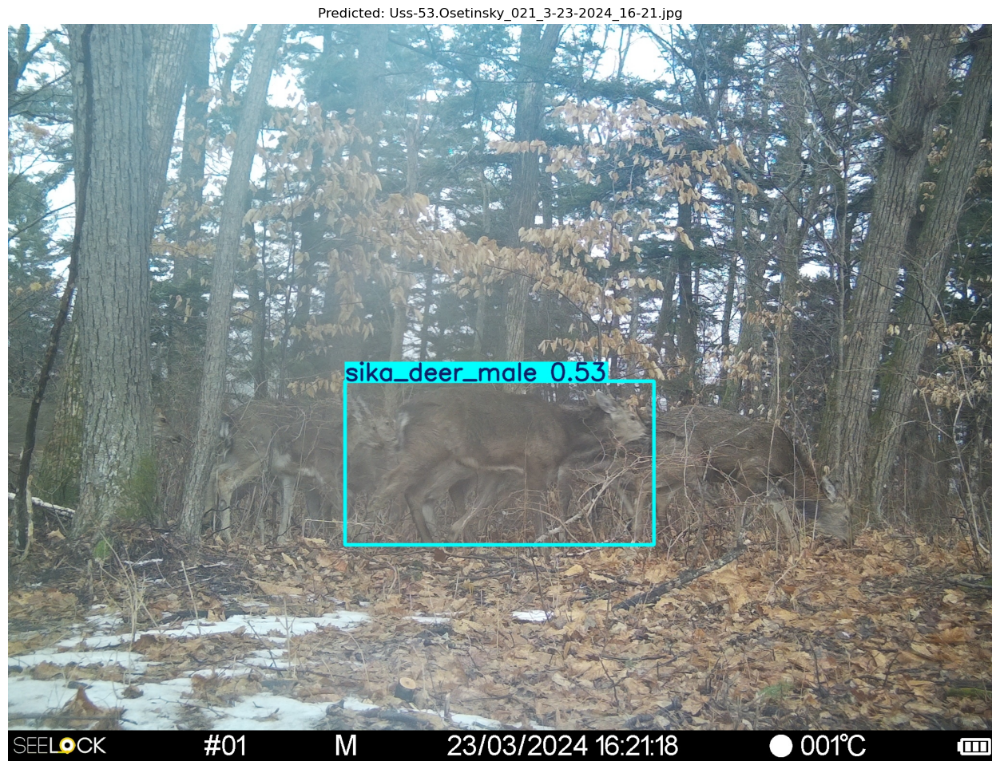

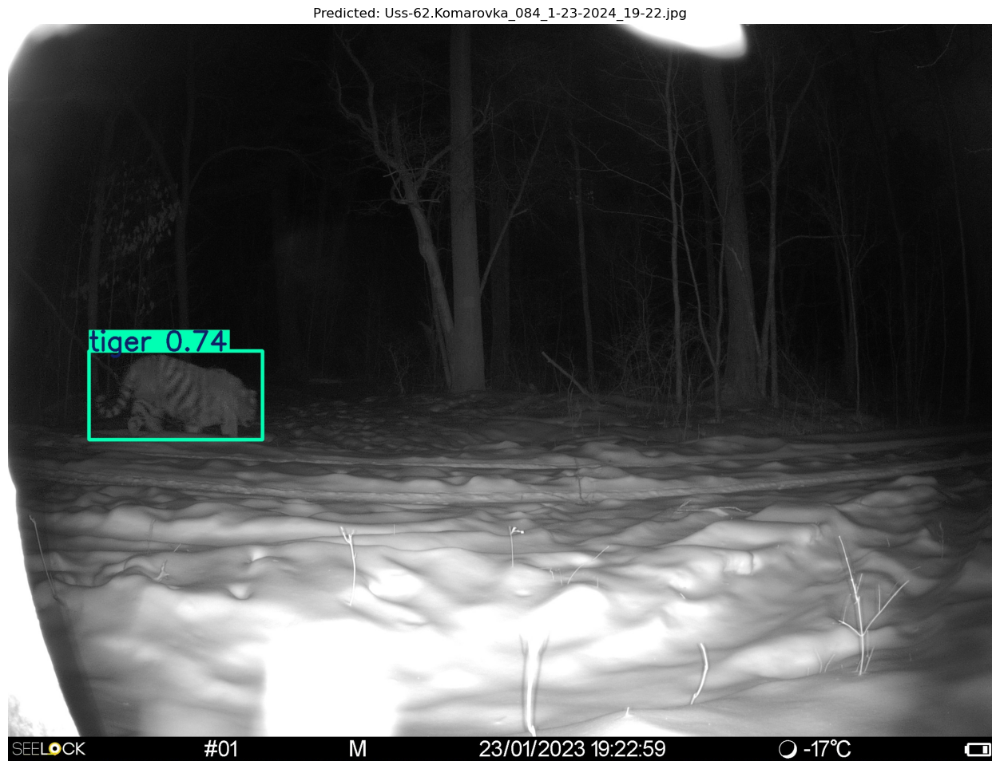

In [49]:
import os
import matplotlib.pyplot as plt
from PIL import Image

# Path to the predict folder
predict_dir = "runs/detect/predict2"

# List all files in the predict folder
predicted_files = [f for f in os.listdir(predict_dir) if f.lower().endswith(('.jpg', '.png', '.jpeg'))]

# Plot each predicted image
for file in predicted_files:
    pred_img_path = os.path.join(predict_dir, file)
    try:
        img = Image.open(pred_img_path)
        plt.figure(figsize=(18, 12))
        plt.imshow(img)
        plt.title(f"Predicted: {file}")
        plt.axis('off')
        plt.show()
    except Exception as e:
        print(f"Error loading {file}: {e}")

## MODEL VERSION: YOLOV5SU

## DATASET: 290

## Manual Label

In [5]:
!pip install ultralytics

  Using cached opencv_python-4.11.0.86-cp37-abi3-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (20 kB)
  Using cached ultralytics_thop-2.0.14-py3-none-any.whl.metadata (9.4 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 994.1/994.1 kB 9.3 MB/s eta 0:00:00
Using cached opencv_python-4.11.0.86-cp37-abi3-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (63.0 MB)
Using cached ultralytics_thop-2.0.14-py3-none-any.whl (26 kB)


In [6]:
from ultralytics import YOLO

In [ ]:
# Load a pretrained YOLO model
MODEL_NAME = "yolov5su.pt"  # later we can use yolov8s.pt, yolov8m.pt to see if we can get better accuracy


# Check if the model file exists
if os.path.exists(MODEL_NAME):
    print(f"Model {MODEL_NAME} loaded successfully.")
else:
    print(f"Model file {MODEL_NAME} not found. Please check the path.")


In [8]:
from ultralytics import YOLO
import os

# Load a pretrained YOLO model
MODEL_NAME = "yolov5su.pt"  
model = YOLO(MODEL_NAME)

if os.path.exists(MODEL_NAME):
    print(f"Model {MODEL_NAME} loaded successfully.")
else:
    print(f"Model file {MODEL_NAME} not found. Please check the path.")


results = model.train(
    data="animals.yaml",  
    epochs=120,           
    batch=16,              
    imgsz=640,             
    augment=True,         
    pretrained=True,       
    save_period=40,        
)

100%|██████████| 17.7M/17.7M [00:00<00:00, 40.5MB/s]


Model yolov5su.pt loaded successfully.
Ultralytics 8.3.104 🚀 Python-3.12.7 torch-2.6.0+cu124 CPU (Intel Xeon Processor (Icelake))
engine/trainer: task=detect, mode=train, model=yolov5su.pt, data=animals.yaml, epochs=120, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=40, cache=False, device=None, workers=8, project=None, name=train8, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=True, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_lab

train: Scanning /home/jovyan/__ANIMALS/datasets/ds0/train/labels.cache... 234 images, 0 backgrounds, 0 corrupt: 100%|██████████| 234/234 [00:00<?, ?it/s]
val: Scanning /home/jovyan/__ANIMALS/datasets/ds0/val/labels.cache... 64 images, 0 backgrounds, 0 corrupt: 100%|██████████| 64/64 [00:00<?, ?it/s]


Plotting labels to runs/detect/train8/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000417, momentum=0.9) with parameter groups 69 weight(decay=0.0), 76 weight(decay=0.0005), 75 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs/detect/train8
Starting training for 120 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/120         0G      1.165      4.325      1.373         33        640: 100%|██████████| 15/15 [01:16<00:00,  5.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:13<00:00,  6.77s/it]

                   all         64         75      0.737      0.138      0.131      0.104



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/120         0G      1.007      2.597      1.256         19        640: 100%|██████████| 15/15 [00:53<00:00,  3.56s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:06<00:00,  3.23s/it]

                   all         64         75      0.717      0.206      0.208      0.154



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/120         0G      1.002      1.993      1.238         19        640: 100%|██████████| 15/15 [00:52<00:00,  3.52s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:05<00:00,  2.51s/it]

                   all         64         75      0.717      0.296      0.269      0.173



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/120         0G     0.8836      1.648      1.116         17        640: 100%|██████████| 15/15 [00:53<00:00,  3.58s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.45s/it]

                   all         64         75      0.588      0.312      0.297      0.217



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/120         0G     0.9655      1.621      1.193         29        640: 100%|██████████| 15/15 [00:53<00:00,  3.57s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.41s/it]

                   all         64         75      0.572      0.331      0.351      0.252



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/120         0G     0.9613      1.511      1.137         26        640: 100%|██████████| 15/15 [00:54<00:00,  3.66s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:05<00:00,  2.56s/it]

                   all         64         75      0.681      0.403      0.366      0.257



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/120         0G     0.9598       1.41      1.145         19        640: 100%|██████████| 15/15 [00:52<00:00,  3.49s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.41s/it]

                   all         64         75      0.635      0.278      0.341      0.257



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/120         0G     0.9013      1.257      1.135         19        640: 100%|██████████| 15/15 [00:52<00:00,  3.49s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:05<00:00,  2.52s/it]

                   all         64         75      0.886      0.334      0.446      0.321



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/120         0G      0.887        1.1      1.109         18        640: 100%|██████████| 15/15 [00:53<00:00,  3.53s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.47s/it]

                   all         64         75      0.913      0.281      0.414      0.307



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/120         0G     0.9018      1.131      1.107         29        640: 100%|██████████| 15/15 [00:51<00:00,  3.45s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.44s/it]

                   all         64         75      0.495      0.437      0.457      0.294



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/120         0G      0.925      1.078      1.129         22        640: 100%|██████████| 15/15 [00:51<00:00,  3.45s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.42s/it]

                   all         64         75      0.914      0.243      0.427      0.268



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/120         0G      0.906      1.041      1.143         17        640: 100%|██████████| 15/15 [00:53<00:00,  3.57s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.41s/it]

                   all         64         75      0.385      0.409      0.445       0.33



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/120         0G     0.8442     0.9359       1.11         26        640: 100%|██████████| 15/15 [00:55<00:00,  3.70s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.48s/it]

                   all         64         75      0.455      0.409       0.48      0.325



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/120         0G     0.8188      0.928      1.095         21        640: 100%|██████████| 15/15 [00:50<00:00,  3.40s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:08<00:00,  4.20s/it]

                   all         64         75      0.822      0.333      0.438      0.289



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/120         0G      0.862     0.9402      1.103         22        640: 100%|██████████| 15/15 [00:51<00:00,  3.42s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.42s/it]

                   all         64         75      0.715      0.372      0.467      0.294



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/120         0G     0.8013     0.8304      1.042         20        640: 100%|██████████| 15/15 [00:52<00:00,  3.52s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.40s/it]

                   all         64         75       0.89      0.386      0.613      0.378



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/120         0G     0.8115     0.8176      1.045         21        640: 100%|██████████| 15/15 [00:51<00:00,  3.41s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.39s/it]

                   all         64         75      0.792      0.367      0.582      0.404



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/120         0G     0.8686     0.8895      1.105         29        640: 100%|██████████| 15/15 [00:51<00:00,  3.43s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.45s/it]

                   all         64         75      0.791      0.423      0.587      0.453



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/120         0G     0.8408     0.8617      1.097         20        640: 100%|██████████| 15/15 [00:51<00:00,  3.46s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.44s/it]

                   all         64         75      0.909      0.346      0.573      0.417



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/120         0G     0.8258     0.8431      1.066         20        640: 100%|██████████| 15/15 [00:53<00:00,  3.55s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.48s/it]

                   all         64         75      0.558      0.496      0.585      0.427



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/120         0G     0.7632     0.8214      1.057         27        640: 100%|██████████| 15/15 [00:53<00:00,  3.58s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.42s/it]

                   all         64         75      0.886      0.449      0.564      0.425



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/120         0G     0.8073     0.8066       1.07         26        640: 100%|██████████| 15/15 [00:51<00:00,  3.44s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.42s/it]

                   all         64         75       0.76      0.439      0.523      0.376



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/120         0G     0.7425     0.7918       1.02         16        640: 100%|██████████| 15/15 [00:53<00:00,  3.57s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.48s/it]

                   all         64         75      0.457      0.427      0.549      0.373



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/120         0G     0.7949     0.8281      1.059         16        640: 100%|██████████| 15/15 [00:53<00:00,  3.58s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.47s/it]

                   all         64         75      0.558      0.473      0.623       0.45



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/120         0G     0.7425     0.7601      1.052         21        640: 100%|██████████| 15/15 [00:53<00:00,  3.58s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.43s/it]

                   all         64         75      0.549      0.559      0.638      0.448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/120         0G     0.7248     0.6683      1.032         21        640: 100%|██████████| 15/15 [00:57<00:00,  3.83s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:05<00:00,  2.62s/it]

                   all         64         75      0.821      0.572      0.653      0.477



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/120         0G     0.7141     0.6598      1.025         18        640: 100%|██████████| 15/15 [00:55<00:00,  3.73s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.48s/it]

                   all         64         75      0.868      0.636      0.729      0.506



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/120         0G     0.7205     0.6734      1.016         16        640: 100%|██████████| 15/15 [00:53<00:00,  3.55s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.46s/it]

                   all         64         75      0.801      0.528      0.729      0.526



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/120         0G      0.695     0.6493      1.006         18        640: 100%|██████████| 15/15 [00:53<00:00,  3.56s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.44s/it]

                   all         64         75      0.851      0.435      0.752      0.533



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/120         0G     0.7044     0.6256      1.024         22        640: 100%|██████████| 15/15 [00:52<00:00,  3.51s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:05<00:00,  2.67s/it]

                   all         64         75      0.787      0.525      0.756      0.543



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/120         0G     0.6856     0.6034      1.018         25        640: 100%|██████████| 15/15 [00:52<00:00,  3.47s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:05<00:00,  2.69s/it]

                   all         64         75      0.668      0.533      0.639      0.464



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/120         0G     0.7004     0.6301     0.9976         22        640: 100%|██████████| 15/15 [00:52<00:00,  3.49s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.43s/it]

                   all         64         75      0.524       0.57      0.661       0.48



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/120         0G     0.6854     0.6405      1.017         21        640: 100%|██████████| 15/15 [00:54<00:00,  3.64s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.47s/it]

                   all         64         75      0.758      0.525      0.664      0.433



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/120         0G     0.6984     0.6296      0.993         24        640: 100%|██████████| 15/15 [00:54<00:00,  3.62s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.44s/it]

                   all         64         75      0.907      0.403      0.776      0.505



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/120         0G     0.6679      0.633      0.999         21        640: 100%|██████████| 15/15 [00:51<00:00,  3.45s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.48s/it]

                   all         64         75      0.682      0.545      0.696       0.49



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/120         0G     0.7077     0.6586      1.016         22        640: 100%|██████████| 15/15 [00:52<00:00,  3.53s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:05<00:00,  2.59s/it]

                   all         64         75      0.916      0.501      0.776      0.566



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/120         0G     0.6983     0.5864     0.9941         29        640: 100%|██████████| 15/15 [00:51<00:00,  3.41s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.41s/it]

                   all         64         75      0.603      0.696      0.739      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/120         0G     0.6685     0.5817     0.9755         14        640: 100%|██████████| 15/15 [00:51<00:00,  3.45s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.40s/it]

                   all         64         75      0.549      0.723      0.773      0.559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/120         0G      0.639     0.5588       0.97         27        640: 100%|██████████| 15/15 [00:55<00:00,  3.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.39s/it]

                   all         64         75      0.681      0.542      0.704      0.525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/120         0G     0.6528     0.5649     0.9877         22        640: 100%|██████████| 15/15 [00:51<00:00,  3.44s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.41s/it]

                   all         64         75      0.892       0.48      0.728       0.55



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/120         0G     0.6614      0.578      1.004         18        640: 100%|██████████| 15/15 [00:51<00:00,  3.41s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.37s/it]

                   all         64         75      0.897      0.513      0.768      0.565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/120         0G     0.6574     0.5577     0.9993         30        640: 100%|██████████| 15/15 [00:51<00:00,  3.42s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.37s/it]

                   all         64         75      0.819      0.527       0.71      0.538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/120         0G     0.6492     0.5669     0.9953         23        640: 100%|██████████| 15/15 [00:51<00:00,  3.42s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.42s/it]

                   all         64         75      0.675      0.607      0.622      0.484



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/120         0G     0.6586      0.536     0.9901         23        640: 100%|██████████| 15/15 [00:51<00:00,  3.46s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.34s/it]

                   all         64         75      0.772      0.644      0.669      0.497



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/120         0G      0.619     0.5148     0.9689         30        640: 100%|██████████| 15/15 [00:52<00:00,  3.52s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:07<00:00,  3.69s/it]

                   all         64         75      0.592      0.656      0.683      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/120         0G     0.6433     0.5512     0.9867         21        640: 100%|██████████| 15/15 [00:50<00:00,  3.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.38s/it]

                   all         64         75       0.84      0.546      0.619      0.506



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/120         0G     0.6285      0.573     0.9926         17        640: 100%|██████████| 15/15 [00:52<00:00,  3.50s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.40s/it]

                   all         64         75      0.862      0.562      0.671      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/120         0G     0.6079     0.5332      0.995         21        640: 100%|██████████| 15/15 [00:52<00:00,  3.53s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.40s/it]

                   all         64         75      0.785      0.634       0.72      0.594



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/120         0G     0.6272     0.5402     0.9651         19        640: 100%|██████████| 15/15 [00:52<00:00,  3.49s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.37s/it]

                   all         64         75      0.606      0.725      0.717      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/120         0G     0.6208     0.5258     0.9852         16        640: 100%|██████████| 15/15 [00:52<00:00,  3.49s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.38s/it]

                   all         64         75      0.747      0.679      0.712      0.575



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/120         0G     0.6338     0.5019     0.9656         16        640: 100%|██████████| 15/15 [00:53<00:00,  3.54s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.43s/it]

                   all         64         75      0.734       0.77      0.809      0.594



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/120         0G     0.6017     0.5071     0.9653         20        640: 100%|██████████| 15/15 [00:53<00:00,  3.57s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.41s/it]

                   all         64         75      0.798      0.796      0.821      0.595



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/120         0G     0.5778     0.4706     0.9534         24        640: 100%|██████████| 15/15 [00:52<00:00,  3.48s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.41s/it]

                   all         64         75        0.6      0.614      0.713      0.575



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/120         0G     0.5971     0.4839     0.9735         32        640: 100%|██████████| 15/15 [00:51<00:00,  3.43s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:07<00:00,  3.61s/it]

                   all         64         75       0.57      0.752      0.747       0.55



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/120         0G     0.5859     0.4817     0.9609         15        640: 100%|██████████| 15/15 [00:53<00:00,  3.54s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.44s/it]

                   all         64         75      0.638      0.679      0.752      0.586



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/120         0G     0.5935     0.4967     0.9595         23        640: 100%|██████████| 15/15 [00:53<00:00,  3.58s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.46s/it]

                   all         64         75      0.691      0.683      0.776      0.551



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/120         0G     0.5739     0.4554     0.9427         19        640: 100%|██████████| 15/15 [00:53<00:00,  3.59s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.47s/it]

                   all         64         75       0.78      0.583      0.702      0.576



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/120         0G     0.5755     0.4943      0.971         12        640: 100%|██████████| 15/15 [00:53<00:00,  3.57s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.46s/it]

                   all         64         75      0.743      0.673      0.722      0.579



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/120         0G     0.5516     0.4551      0.945         24        640: 100%|██████████| 15/15 [00:52<00:00,  3.47s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.48s/it]

                   all         64         75       0.62      0.786      0.756      0.592



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/120         0G     0.5481     0.4328     0.9374         25        640: 100%|██████████| 15/15 [00:52<00:00,  3.48s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.42s/it]

                   all         64         75      0.635      0.679      0.761       0.58



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/120         0G     0.5352     0.4492     0.9511         17        640: 100%|██████████| 15/15 [00:52<00:00,  3.47s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.41s/it]

                   all         64         75       0.68      0.588      0.765      0.585



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/120         0G     0.5369      0.443     0.9367         21        640: 100%|██████████| 15/15 [00:51<00:00,  3.44s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.44s/it]

                   all         64         75      0.729      0.564      0.798      0.626



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/120         0G     0.5404     0.4346     0.9432         21        640: 100%|██████████| 15/15 [00:55<00:00,  3.70s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.44s/it]

                   all         64         75      0.783       0.68      0.808      0.594



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/120         0G     0.5619      0.468     0.9598         20        640: 100%|██████████| 15/15 [00:54<00:00,  3.61s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:05<00:00,  2.51s/it]

                   all         64         75      0.648      0.547      0.748      0.583



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/120         0G     0.5623     0.4468     0.9711         24        640: 100%|██████████| 15/15 [00:54<00:00,  3.64s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:05<00:00,  2.55s/it]

                   all         64         75      0.743      0.661      0.751      0.581



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/120         0G     0.5465     0.4298     0.9413         19        640: 100%|██████████| 15/15 [00:53<00:00,  3.57s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.45s/it]

                   all         64         75      0.757      0.653       0.83      0.614



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/120         0G     0.5405     0.4289     0.9413         22        640: 100%|██████████| 15/15 [00:52<00:00,  3.52s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.44s/it]

                   all         64         75      0.745      0.752      0.805      0.593



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/120         0G      0.518     0.4115     0.9335         20        640: 100%|██████████| 15/15 [00:53<00:00,  3.53s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.43s/it]

                   all         64         75      0.782      0.661      0.819      0.629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/120         0G     0.5418     0.4276      0.952         14        640: 100%|██████████| 15/15 [00:53<00:00,  3.59s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.44s/it]

                   all         64         75      0.606      0.661      0.753      0.588



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/120         0G     0.5037      0.416     0.9324         22        640: 100%|██████████| 15/15 [00:52<00:00,  3.52s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.48s/it]

                   all         64         75      0.746      0.638      0.754      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/120         0G     0.4915     0.4033     0.9223         21        640: 100%|██████████| 15/15 [00:52<00:00,  3.52s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.49s/it]

                   all         64         75      0.544      0.744      0.755      0.552



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/120         0G     0.5071     0.4031     0.9483         14        640: 100%|██████████| 15/15 [00:51<00:00,  3.45s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.44s/it]

                   all         64         75      0.557      0.744      0.749      0.538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/120         0G     0.5014     0.4316     0.9238         30        640: 100%|██████████| 15/15 [00:52<00:00,  3.50s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.44s/it]

                   all         64         75      0.735      0.668      0.765      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/120         0G     0.4817     0.3957     0.9182         19        640: 100%|██████████| 15/15 [00:51<00:00,  3.45s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.47s/it]

                   all         64         75      0.701      0.764      0.773      0.572



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/120         0G     0.5029     0.3935     0.9129         24        640: 100%|██████████| 15/15 [00:53<00:00,  3.58s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:05<00:00,  2.52s/it]

                   all         64         75      0.679      0.766      0.774      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/120         0G     0.4764     0.4063     0.9196         23        640: 100%|██████████| 15/15 [00:52<00:00,  3.50s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.40s/it]

                   all         64         75      0.799      0.672      0.775      0.553



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/120         0G     0.4736     0.3958     0.9265         17        640: 100%|██████████| 15/15 [00:50<00:00,  3.40s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.38s/it]

                   all         64         75      0.879      0.658      0.774      0.552



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/120         0G     0.5092     0.3922     0.9334         19        640: 100%|██████████| 15/15 [00:50<00:00,  3.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.42s/it]

                   all         64         75      0.805      0.666      0.773      0.566



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/120         0G     0.4909     0.3716     0.9271         21        640: 100%|██████████| 15/15 [00:53<00:00,  3.53s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.40s/it]

                   all         64         75      0.705      0.684      0.783      0.603



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/120         0G     0.4931     0.3911     0.9259         24        640: 100%|██████████| 15/15 [00:53<00:00,  3.54s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.34s/it]

                   all         64         75       0.68       0.68      0.717      0.585



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/120         0G     0.4774     0.3744     0.9087         20        640: 100%|██████████| 15/15 [00:52<00:00,  3.49s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.37s/it]

                   all         64         75       0.71      0.575      0.708      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/120         0G     0.4694     0.3961     0.9182         25        640: 100%|██████████| 15/15 [00:50<00:00,  3.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:07<00:00,  3.77s/it]

                   all         64         75       0.82      0.575      0.695      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/120         0G     0.4673     0.3816     0.9313         18        640: 100%|██████████| 15/15 [00:50<00:00,  3.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.41s/it]

                   all         64         75      0.793      0.666      0.702      0.562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/120         0G     0.4665     0.3773     0.9211         34        640: 100%|██████████| 15/15 [00:51<00:00,  3.45s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.36s/it]

                   all         64         75      0.864      0.682       0.74      0.558



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/120         0G     0.4478     0.3592     0.9305         19        640: 100%|██████████| 15/15 [00:52<00:00,  3.50s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.43s/it]

                   all         64         75       0.88      0.682      0.786      0.554



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/120         0G      0.461     0.3625      0.917         30        640: 100%|██████████| 15/15 [00:54<00:00,  3.66s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.43s/it]

                   all         64         75      0.862      0.682      0.787       0.56



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/120         0G     0.4574     0.3465     0.9189         22        640: 100%|██████████| 15/15 [00:53<00:00,  3.58s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.45s/it]

                   all         64         75      0.766      0.739      0.746      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/120         0G      0.449     0.3604        0.9         22        640: 100%|██████████| 15/15 [00:54<00:00,  3.63s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.42s/it]

                   all         64         75      0.705      0.746      0.759       0.57



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/120         0G      0.462     0.3795     0.9086         23        640: 100%|██████████| 15/15 [00:54<00:00,  3.64s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.46s/it]

                   all         64         75      0.727      0.693      0.767      0.609



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/120         0G     0.4518     0.3529     0.9147         18        640: 100%|██████████| 15/15 [00:52<00:00,  3.53s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.48s/it]

                   all         64         75      0.756      0.683      0.793      0.587



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/120         0G     0.4076     0.3423     0.8878         25        640: 100%|██████████| 15/15 [00:53<00:00,  3.57s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.47s/it]

                   all         64         75      0.593      0.766      0.789      0.577



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/120         0G     0.4321     0.3271     0.9059         27        640: 100%|██████████| 15/15 [00:51<00:00,  3.44s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.40s/it]

                   all         64         75       0.74      0.684      0.726      0.538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/120         0G     0.4302      0.338      0.905         26        640: 100%|██████████| 15/15 [00:54<00:00,  3.65s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.43s/it]

                   all         64         75      0.701      0.668      0.732      0.558



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/120         0G      0.473     0.3578      0.941         15        640: 100%|██████████| 15/15 [00:54<00:00,  3.61s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.42s/it]

                   all         64         75      0.736      0.663      0.732      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/120         0G     0.4553     0.3626     0.9063         16        640: 100%|██████████| 15/15 [00:54<00:00,  3.62s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.41s/it]

                   all         64         75      0.686      0.752      0.773      0.573



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/120         0G      0.429      0.327     0.8912         23        640: 100%|██████████| 15/15 [00:53<00:00,  3.54s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.42s/it]

                   all         64         75      0.678      0.752      0.774      0.587



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/120         0G      0.424     0.3548     0.9116         25        640: 100%|██████████| 15/15 [00:53<00:00,  3.56s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:05<00:00,  2.53s/it]

                   all         64         75      0.724      0.751      0.773      0.581



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/120         0G     0.4223     0.3278     0.8993         18        640: 100%|██████████| 15/15 [00:55<00:00,  3.68s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.44s/it]

                   all         64         75      0.755      0.748      0.776      0.573



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/120         0G     0.4436     0.3271     0.9129         26        640: 100%|██████████| 15/15 [00:53<00:00,  3.58s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.42s/it]

                   all         64         75      0.783      0.779      0.783      0.586



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/120         0G     0.4348     0.3345     0.9078         21        640: 100%|██████████| 15/15 [00:52<00:00,  3.51s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.48s/it]

                   all         64         75      0.764      0.791      0.785      0.585



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    101/120         0G     0.4235     0.3313     0.9042         20        640: 100%|██████████| 15/15 [00:52<00:00,  3.50s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.46s/it]

                   all         64         75      0.776      0.778      0.785      0.582



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    102/120         0G     0.4212     0.3302      0.913         15        640: 100%|██████████| 15/15 [00:53<00:00,  3.58s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.43s/it]

                   all         64         75      0.873      0.771      0.785      0.593



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    103/120         0G     0.4152     0.3411     0.9089         20        640: 100%|██████████| 15/15 [00:53<00:00,  3.55s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.43s/it]

                   all         64         75      0.833      0.772      0.781      0.599



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    104/120         0G     0.4132     0.3223     0.9021         22        640: 100%|██████████| 15/15 [00:54<00:00,  3.64s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.44s/it]

                   all         64         75      0.857      0.775      0.787      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    105/120         0G      0.417     0.3181     0.9051         27        640: 100%|██████████| 15/15 [00:53<00:00,  3.58s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.42s/it]

                   all         64         75      0.831      0.752      0.778      0.596



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    106/120         0G     0.4069      0.323     0.8947         28        640: 100%|██████████| 15/15 [00:54<00:00,  3.63s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.42s/it]

                   all         64         75      0.812      0.775      0.787      0.586



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    107/120         0G     0.4121     0.3122     0.9083         28        640: 100%|██████████| 15/15 [00:55<00:00,  3.70s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.42s/it]

                   all         64         75      0.731      0.752      0.779      0.582



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    108/120         0G      0.397     0.3249     0.8921         25        640: 100%|██████████| 15/15 [00:56<00:00,  3.74s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:05<00:00,  2.51s/it]

                   all         64         75      0.702      0.729      0.771      0.582



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    109/120         0G     0.3681     0.2896     0.8808         17        640: 100%|██████████| 15/15 [00:52<00:00,  3.49s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:08<00:00,  4.36s/it]

                   all         64         75      0.726      0.748       0.77      0.581



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    110/120         0G     0.4084     0.3219     0.8964         20        640: 100%|██████████| 15/15 [00:52<00:00,  3.47s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.42s/it]

                   all         64         75      0.745      0.793      0.793      0.595


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    111/120         0G      0.354     0.2825     0.8452         11        640: 100%|██████████| 15/15 [00:51<00:00,  3.45s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.43s/it]

                   all         64         75      0.723      0.792      0.747      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    112/120         0G     0.3203     0.2596     0.8309         10        640: 100%|██████████| 15/15 [00:51<00:00,  3.41s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.38s/it]

                   all         64         75      0.623      0.793      0.747      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    113/120         0G     0.3208     0.2547     0.8427         10        640: 100%|██████████| 15/15 [00:52<00:00,  3.52s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.38s/it]

                   all         64         75      0.622      0.793      0.762      0.575



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    114/120         0G     0.3117     0.2417     0.8474         12        640: 100%|██████████| 15/15 [00:52<00:00,  3.50s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.40s/it]

                   all         64         75      0.639      0.792      0.762      0.575



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    115/120         0G      0.312     0.2401      0.824         10        640: 100%|██████████| 15/15 [00:51<00:00,  3.46s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.45s/it]

                   all         64         75      0.654      0.789       0.76      0.582



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    116/120         0G     0.2969     0.2377     0.8155         10        640: 100%|██████████| 15/15 [00:53<00:00,  3.57s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.43s/it]

                   all         64         75       0.62      0.743      0.743      0.585



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    117/120         0G     0.3048     0.2421     0.8269         10        640: 100%|██████████| 15/15 [00:52<00:00,  3.53s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.40s/it]

                   all         64         75      0.627      0.742      0.743      0.578



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    118/120         0G     0.2926     0.2291     0.8271         11        640: 100%|██████████| 15/15 [00:51<00:00,  3.43s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:08<00:00,  4.35s/it]

                   all         64         75      0.659      0.788      0.762      0.583



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    119/120         0G     0.2821     0.2297      0.822         10        640: 100%|██████████| 15/15 [00:50<00:00,  3.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.39s/it]

                   all         64         75      0.661      0.788      0.763      0.583



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    120/120         0G     0.2905     0.2261     0.8188         10        640: 100%|██████████| 15/15 [00:53<00:00,  3.54s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.44s/it]

                   all         64         75       0.65      0.789      0.763      0.581



120 epochs completed in 1.954 hours.
Optimizer stripped from runs/detect/train8/weights/last.pt, 18.5MB
Optimizer stripped from runs/detect/train8/weights/best.pt, 18.5MB

Validating runs/detect/train8/weights/best.pt...
Ultralytics 8.3.104 🚀 Python-3.12.7 torch-2.6.0+cu124 CPU (Intel Xeon Processor (Icelake))
YOLOv5s summary (fused): 84 layers, 9,119,276 parameters, 0 gradients, 23.9 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:07<00:00,  3.87s/it]


                   all         64         75      0.917      0.555      0.839      0.626
                badger          1          1          1          0      0.995      0.497
                  boar          4          4       0.93        0.5      0.599      0.426
                  lynx          2          2          1          0      0.828      0.623
               red_fox          1          1          1          0          0          0
       roe_deer_female          6         11      0.776          1      0.988      0.877
         roe_deer_male          5          5      0.939        0.8      0.862      0.774
      sika_deer_female          4          8      0.823          1      0.995      0.933
        sika_deer_male          2          2          1       0.85      0.995      0.601
                 tiger         38         39      0.974      0.957      0.979       0.86
              wild_cat          1          1          1          0      0.995      0.597
         yellow_marte

In [10]:
  # Run validation
results = model.val(
        data='animals.yaml',
        split='val',
        save_json=True,
        save_conf=True,
        save_txt=True
)

Ultralytics 8.3.104 🚀 Python-3.12.7 torch-2.6.0+cu124 CPU (Intel Xeon Processor (Icelake))
YOLOv5s summary (fused): 84 layers, 9,119,276 parameters, 0 gradients, 23.9 GFLOPs


val: Scanning /home/jovyan/__ANIMALS/datasets/ds0/val/labels.cache... 64 images, 0 backgrounds, 0 corrupt: 100%|██████████| 64/64 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:07<00:00,  1.96s/it]


                   all         64         75      0.917      0.555      0.839      0.626
                badger          1          1          1          0      0.995      0.497
                  boar          4          4       0.93        0.5      0.599      0.426
                  lynx          2          2          1          0      0.828      0.623
               red_fox          1          1          1          0          0          0
       roe_deer_female          6         11      0.776          1      0.988      0.877
         roe_deer_male          5          5      0.939        0.8      0.862      0.774
      sika_deer_female          4          8      0.823          1      0.995      0.933
        sika_deer_male          2          2          1       0.85      0.995      0.601
                 tiger         38         39      0.974      0.957      0.979       0.86
              wild_cat          1          1          1          0      0.995      0.597
         yellow_marte

In [11]:
from ultralytics import YOLO
import pandas as pd

def analyze_yolo_results(model_path, data_yaml):
    """
    Analyze YOLO validation results and return a DataFrame with performance metrics.
    
    Args:
        model_path (str): Path to the trained YOLO model weights (.pt file).
        data_yaml (str): Path to the dataset configuration file (animals.yaml).
    
    Returns:
        pd.DataFrame: A DataFrame containing metrics for each class.
    """
    # Load the trained YOLO model
    model = YOLO(model_path)
    
    # Run validation on the dataset
    results = model.val(
        data=data_yaml,
        split='val',          # Validate on the validation set
        save_json=True,       # Save predictions in JSON format
        save_conf=True,       # Include confidence scores
        save_txt=True         # Save predictions in plain text format
    )
    
    # Extract overall metrics from the results
    class_names = results.names  # Class names from the model
    num_classes = len(class_names)
    
    # Initialize a list to store metrics for each class
    metrics = []
    
    # Process metrics for each class
    for class_id in range(num_classes):
        class_name = class_names[class_id]
        
        # Check if the class has any detections
        detected = False
        instances = 0
        precision = recall = ap50 = ap50_95 = f1_score = 0
        
        if hasattr(results, 'box') and results.box is not None:
            if class_id < len(results.box.p):  # Precision
                precision = results.box.p[class_id]
            if class_id < len(results.box.r):  # Recall
                recall = results.box.r[class_id]
            if class_id < len(results.box.ap50):  # AP50
                ap50 = results.box.ap50[class_id]
            if class_id < len(results.box.ap):  # AP50-95
                ap50_95 = results.box.ap[class_id]
            
            # Calculate F1 score
            if precision + recall > 0:
                f1_score = 2 * (precision * recall) / (precision + recall)
            
            # Count instances
            instances = results.box.instances[class_id] if hasattr(results.box, 'instances') else 0
            
            # Mark class as detected if it has at least one instance
            detected = instances > 0
        
        # Append metrics for this class
        metrics.append({
            'Class ID': class_id,
            'Class Name': class_name,
            'Precision': precision,
            'Recall': recall,
            'AP50': ap50,
            'AP50-95': ap50_95,
            'F1 Score': f1_score,
            'Detected': detected,
            'Instances': instances
        })
    
    # Create a DataFrame from the metrics
    df_metrics = pd.DataFrame(metrics)
    
    # Print summary of overall performance
    print("=== Model Validation Summary ===")
    print(f"mAP50: {results.box.map50:.4f}")
    print(f"mAP50-95: {results.box.map:.4f}")
    print(f"Mean Precision: {results.box.mp:.4f}")
    print(f"Mean Recall: {results.box.mr:.4f}")
    print(f"Mean F1 Score: {2 * (results.box.mp * results.box.mr) / (results.box.mp + results.box.mr):.4f}")
    
    # Print inference speed metrics
    print("\n=== Inference Speed Metrics ===")
    print(f"Preprocess: {results.speed['preprocess']:.1f} ms/img")
    print(f"Inference: {results.speed['inference']:.1f} ms/img")
    print(f"Postprocess: {results.speed['postprocess']:.1f} ms/img")
    
    return df_metrics


# Usage Example
if __name__ == "__main__":
    # Define paths
    MODEL_PATH = "/home/jovyan/__ANIMALS/datasets/ds0/runs/detect/train5/weights/best.pt"
    DATA_YAML = "animals.yaml"
    
    # Analyze validation results
    df_metrics = analyze_yolo_results(MODEL_PATH, DATA_YAML)
    
    # Display metrics for detected classes only
    print("\nMetrics for Detected Classes:")
    print(df_metrics[df_metrics['Detected']])

Ultralytics 8.3.104 🚀 Python-3.12.7 torch-2.6.0+cu124 CPU (Intel Xeon Processor (Icelake))
Model summary (fused): 72 layers, 3,009,548 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /home/jovyan/__ANIMALS/datasets/ds0/val/labels.cache... 64 images, 0 backgrounds, 0 corrupt: 100%|██████████| 64/64 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.16it/s]


                   all         64         75      0.925      0.504      0.621      0.512
                badger          1          1          1          0      0.332      0.146
                  boar          4          4      0.853        0.5      0.639      0.433
                  lynx          2          2          1          0      0.182      0.138
               red_fox          1          1          1          0          0          0
       roe_deer_female          6         11      0.785          1      0.981      0.879
         roe_deer_male          5          5      0.877        0.6      0.928      0.784
        sika_deer_male          4          8      0.906          1      0.995      0.941
        sika_deer_male          2          2      0.954        0.5      0.828      0.597
                 tiger         38         39      0.965      0.949      0.954      0.822
              wild_cat          1          1          1          0          0          0
         yellow_marte